In [1]:
import scanpy as sc
import scvi
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import seaborn as sns

# Need for benchmarking clustering res
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (


In [2]:
# Read in the atlas
adata = sc.read_h5ad('/project/data/gew123/Spatial/Objects/Reference_atlas_annotated_ALLGENES_UPDATED.h5ad')

In [38]:
# Subset to just immune cells
immune = ['Active T cells', 'Macrophages / Monocytes', 'B cells',
          'Helper T cells', 'Mast cells', 'NK cells', 'Naïve T cells',
          'Plasma cells']

adata = adata[adata.obs['manual_labels'].isin(immune)]

In [ ]:
# Reset raw counts
adata.X = adata.layers['raw_counts'].copy()

In [66]:
# Filter out genes not expressed in any cell
sc.pp.filter_genes(adata, min_cells=10)

In [ ]:
# Filter out MT genes

In [67]:
# Check
adata

AnnData object with n_obs × n_vars = 68383 × 29392
    obs: 'Source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'leiden_res0.7', 'leiden_res0.9', 'manual_labels'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'Source_colors', '_scvi_manager_uuid', '_scvi_uuid', 'dea_leiden_0.9', 'dendrogram_leiden_res0.9', 'hvg', 'leiden', 'leiden_res0.7_colors', 'leiden_res0.9_colors', 'manual_labels_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'raw_cou

#### Trying scVI bactch correction to see if that improves clusters

In [12]:
adata_hvg = adata.copy()

In [15]:
# Select top 3000 highly variable genes
sc.pp.highly_variable_genes(
    adata_hvg, n_top_genes=4000, flavor="cell_ranger", batch_key='Source'
)

0    14077
1     9709
2     3613
3     1264
4      445
5      211
6       73
Name: highly_variable_nbatches, dtype: int64

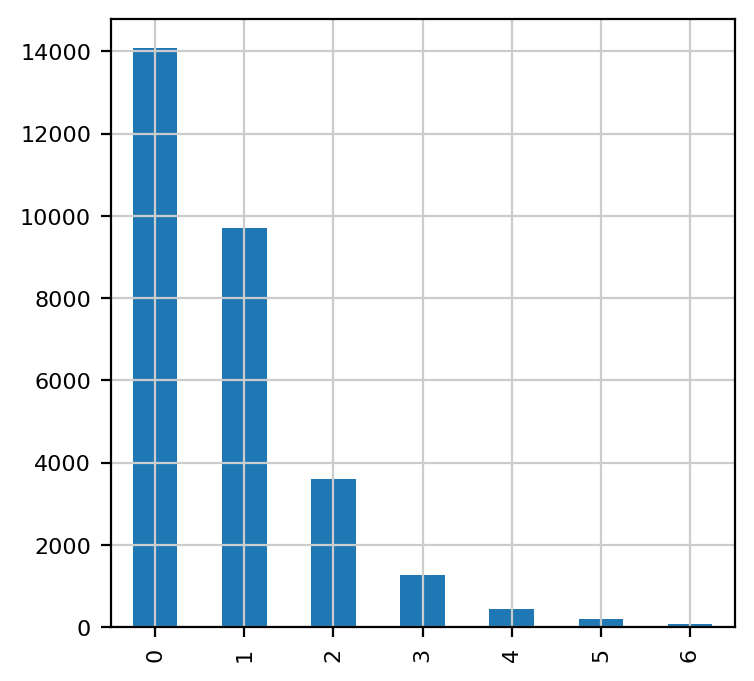

In [16]:
# Check how many batches each gene was variable in 
n_batches = adata_hvg.var["highly_variable_nbatches"].value_counts() # Get counts per gene (0-6)
ax = n_batches.plot(kind="bar") # Plot 
n_batches

In [17]:
# Subset hvgs for integration
adata_hvg = adata[:, adata.var["highly_variable"]].copy()

In [18]:
adata_hvg

AnnData object with n_obs × n_vars = 68383 × 4000
    obs: 'Source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'leiden_res0.7', 'leiden_res0.9', 'manual_labels', 'leiden_res_default', 'leiden_res_0.4', 'leiden_res_0.5', 'leiden_res_0.6', 'leiden_res_0.7'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'Source_colors', '_scvi_manager_uuid', '_scvi_uuid', 'dea_leiden_0.4', 'dea_leiden_0.7', 'dea_leiden_0.9', 'dendrogram_leiden_res0.9', 'dendrogram_leiden_res_0.4', 'dendrogram_leid

In [20]:
adata_scvi = adata_hvg.copy()

In [23]:
# Prepare data
scvi.model.SCVI.setup_anndata(adata_scvi, layer="raw_counts", batch_key='Source') # Using raw counts

<frozen abc>:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.layers[raw_counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [24]:
# Construct model
model_scvi = scvi.model.SCVI(adata_scvi)
model_scvi

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal
Training status: Not Trained
Model's adata is minified?: False

In [25]:
max_epochs_scvi = np.min([round((20000 / adata_scvi.n_obs) * 400), 400])
max_epochs_scvi

117

In [26]:
model_scvi.train(max_epochs=117, early_stopping=True, check_val_every_n_epoch=4)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 1/117:   0%|                                      | 0/117 [00:00<?, ?it/s]

<frozen abc>:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/117:   1%| | 1/117 [00:12<24:09, 12.50s/it, v_num=1, train_loss_step=511

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/117:   2%| | 2/117 [00:25<24:11, 12.62s/it, v_num=1, train_loss_step=444

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/117:   3%| | 3/117 [00:37<23:49, 12.54s/it, v_num=1, train_loss_step=431

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/117:   3%| | 4/117 [00:50<23:32, 12.50s/it, v_num=1, train_loss_step=416

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/117:   4%| | 5/117 [01:02<23:15, 12.46s/it, v_num=1, train_loss_step=450

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/117:   5%| | 6/117 [01:14<23:00, 12.44s/it, v_num=1, train_loss_step=440

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/117:   6%| | 7/117 [01:27<22:47, 12.43s/it, v_num=1, train_loss_step=487

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/117:   7%| | 8/117 [01:39<22:37, 12.45s/it, v_num=1, train_loss_step=464

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/117:   8%| | 9/117 [01:52<22:22, 12.43s/it, v_num=1, train_loss_step=46

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/117:   9%| | 10/117 [02:04<22:21, 12.53s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/117:   9%| | 11/117 [02:18<22:31, 12.75s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/117:  10%| | 12/117 [02:30<22:13, 12.70s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/117:  11%| | 13/117 [02:43<21:51, 12.61s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/117:  12%| | 14/117 [02:55<21:32, 12.55s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/117:  13%|▏| 15/117 [03:08<21:17, 12.52s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/117:  14%|▏| 16/117 [03:21<21:28, 12.75s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/117:  15%|▏| 17/117 [03:35<21:57, 13.18s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/117:  15%|▏| 18/117 [03:49<22:17, 13.51s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/117:  16%|▏| 19/117 [04:03<21:59, 13.47s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/117:  17%|▏| 20/117 [04:16<21:54, 13.55s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/117:  18%|▏| 21/117 [04:31<22:02, 13.78s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/117:  19%|▏| 22/117 [04:45<21:59, 13.89s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/117:  20%|▏| 23/117 [04:58<21:13, 13.54s/it, v_num=1, train_loss_step=3

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/117:  21%|▏| 24/117 [05:11<20:58, 13.53s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/117:  21%|▏| 25/117 [05:25<21:00, 13.70s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/117:  22%|▏| 26/117 [05:38<20:27, 13.49s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/117:  23%|▏| 27/117 [05:51<20:05, 13.40s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/117:  24%|▏| 28/117 [06:05<20:00, 13.49s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/117:  25%|▏| 29/117 [06:20<20:15, 13.81s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/117:  26%|▎| 30/117 [06:33<19:52, 13.70s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/117:  26%|▎| 31/117 [06:46<19:21, 13.51s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/117:  27%|▎| 32/117 [07:01<19:31, 13.78s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 34/117:  28%|▎| 33/117 [07:14<18:59, 13.56s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 35/117:  29%|▎| 34/117 [07:26<18:16, 13.21s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 36/117:  30%|▎| 35/117 [07:38<17:43, 12.97s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 37/117:  31%|▎| 36/117 [07:51<17:19, 12.83s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 38/117:  32%|▎| 37/117 [08:04<17:08, 12.86s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 39/117:  32%|▎| 38/117 [08:19<17:40, 13.43s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 40/117:  33%|▎| 39/117 [08:33<17:59, 13.84s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 41/117:  34%|▎| 40/117 [08:48<17:54, 13.95s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 42/117:  35%|▎| 41/117 [09:02<17:44, 14.01s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 43/117:  36%|▎| 42/117 [09:14<16:59, 13.59s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 44/117:  37%|▎| 43/117 [09:27<16:32, 13.41s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 45/117:  38%|▍| 44/117 [09:41<16:18, 13.41s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 46/117:  38%|▍| 45/117 [09:53<15:44, 13.12s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 47/117:  39%|▍| 46/117 [10:06<15:17, 12.92s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 48/117:  40%|▍| 47/117 [10:18<14:52, 12.75s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 49/117:  41%|▍| 48/117 [10:30<14:32, 12.64s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/117:  42%|▍| 49/117 [10:43<14:20, 12.66s/it, v_num=1, train_loss_step=3

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 51/117:  43%|▍| 50/117 [10:56<14:08, 12.66s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 52/117:  44%|▍| 51/117 [11:08<13:51, 12.60s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 53/117:  44%|▍| 52/117 [11:22<14:04, 13.00s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 54/117:  45%|▍| 53/117 [11:35<13:54, 13.04s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 55/117:  46%|▍| 54/117 [11:50<14:08, 13.46s/it, v_num=1, train_loss_step=5

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 56/117:  47%|▍| 55/117 [12:03<13:54, 13.47s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 57/117:  48%|▍| 56/117 [12:17<13:48, 13.58s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 58/117:  49%|▍| 57/117 [12:30<13:31, 13.52s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 59/117:  50%|▍| 58/117 [12:43<12:57, 13.17s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 60/117:  50%|▌| 59/117 [12:56<12:51, 13.30s/it, v_num=1, train_loss_step=3

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 61/117:  51%|▌| 60/117 [13:10<12:50, 13.53s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 62/117:  52%|▌| 61/117 [13:25<12:54, 13.83s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 63/117:  53%|▌| 62/117 [13:38<12:29, 13.63s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 64/117:  54%|▌| 63/117 [13:51<12:11, 13.54s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 65/117:  55%|▌| 64/117 [14:04<11:39, 13.20s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 66/117:  56%|▌| 65/117 [14:16<11:15, 12.99s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 67/117:  56%|▌| 66/117 [14:29<10:54, 12.83s/it, v_num=1, train_loss_step=3

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 68/117:  57%|▌| 67/117 [14:41<10:36, 12.72s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 69/117:  58%|▌| 68/117 [14:54<10:26, 12.78s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 70/117:  59%|▌| 69/117 [15:08<10:25, 13.03s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 71/117:  60%|▌| 70/117 [15:21<10:16, 13.13s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 72/117:  61%|▌| 71/117 [15:35<10:10, 13.27s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 73/117:  62%|▌| 72/117 [15:47<09:47, 13.06s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 74/117:  62%|▌| 73/117 [16:01<09:36, 13.10s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 75/117:  63%|▋| 74/117 [16:14<09:22, 13.08s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 76/117:  64%|▋| 75/117 [16:26<09:01, 12.89s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 77/117:  65%|▋| 76/117 [16:39<08:50, 12.95s/it, v_num=1, train_loss_step=3

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 78/117:  66%|▋| 77/117 [16:52<08:41, 13.04s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 79/117:  67%|▋| 78/117 [17:06<08:39, 13.32s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 80/117:  68%|▋| 79/117 [17:20<08:35, 13.56s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 81/117:  68%|▋| 80/117 [17:35<08:30, 13.80s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 82/117:  69%|▋| 81/117 [17:48<08:14, 13.73s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 83/117:  70%|▋| 82/117 [18:03<08:06, 13.90s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 84/117:  71%|▋| 83/117 [18:15<07:40, 13.54s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 85/117:  72%|▋| 84/117 [18:28<07:15, 13.21s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 86/117:  73%|▋| 85/117 [18:40<06:55, 12.99s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 87/117:  74%|▋| 86/117 [18:53<06:36, 12.78s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 88/117:  74%|▋| 87/117 [19:05<06:20, 12.70s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 89/117:  75%|▊| 88/117 [19:18<06:06, 12.65s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 90/117:  76%|▊| 89/117 [19:31<06:03, 12.99s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 91/117:  77%|▊| 90/117 [19:46<06:00, 13.35s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 92/117:  78%|▊| 91/117 [20:00<05:55, 13.68s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 93/117:  79%|▊| 92/117 [20:14<05:41, 13.66s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 94/117:  79%|▊| 93/117 [20:27<05:26, 13.61s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 95/117:  80%|▊| 94/117 [20:41<05:12, 13.59s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 96/117:  81%|▊| 95/117 [20:53<04:53, 13.33s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 97/117:  82%|▊| 96/117 [21:08<04:45, 13.59s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 98/117:  83%|▊| 97/117 [21:21<04:28, 13.44s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 99/117:  84%|▊| 98/117 [21:35<04:20, 13.71s/it, v_num=1, train_loss_step=4

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 100/117:  85%|▊| 99/117 [21:49<04:10, 13.90s/it, v_num=1, train_loss_step=

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 101/117:  85%|▊| 100/117 [22:02<03:52, 13.65s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 102/117:  86%|▊| 101/117 [22:16<03:38, 13.67s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 103/117:  87%|▊| 102/117 [22:30<03:24, 13.63s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 104/117:  88%|▉| 103/117 [22:42<03:05, 13.24s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 105/117:  89%|▉| 104/117 [22:56<02:52, 13.30s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 106/117:  90%|▉| 105/117 [23:09<02:38, 13.25s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 107/117:  91%|▉| 106/117 [23:23<02:30, 13.66s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 108/117:  91%|▉| 107/117 [23:37<02:17, 13.76s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 109/117:  92%|▉| 108/117 [23:51<02:04, 13.80s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 110/117:  93%|▉| 109/117 [24:05<01:50, 13.85s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 111/117:  94%|▉| 110/117 [24:20<01:38, 14.04s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 112/117:  95%|▉| 111/117 [24:34<01:24, 14.09s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 113/117:  96%|▉| 112/117 [24:48<01:10, 14.19s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 114/117:  97%|▉| 113/117 [25:02<00:56, 14.20s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 115/117:  97%|▉| 114/117 [25:16<00:41, 13.87s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 116/117:  98%|▉| 115/117 [25:29<00:27, 13.78s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 117/117:  99%|▉| 116/117 [25:41<00:13, 13.29s/it, v_num=1, train_loss_step

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scvi/module/_vae.py:477: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 117/117: 100%|█| 117/117 [25:53<00:00, 12.96s/it, v_num=1, train_loss_step

`Trainer.fit` stopped: `max_epochs=117` reached.


Epoch 117/117: 100%|█| 117/117 [25:53<00:00, 13.28s/it, v_num=1, train_loss_step


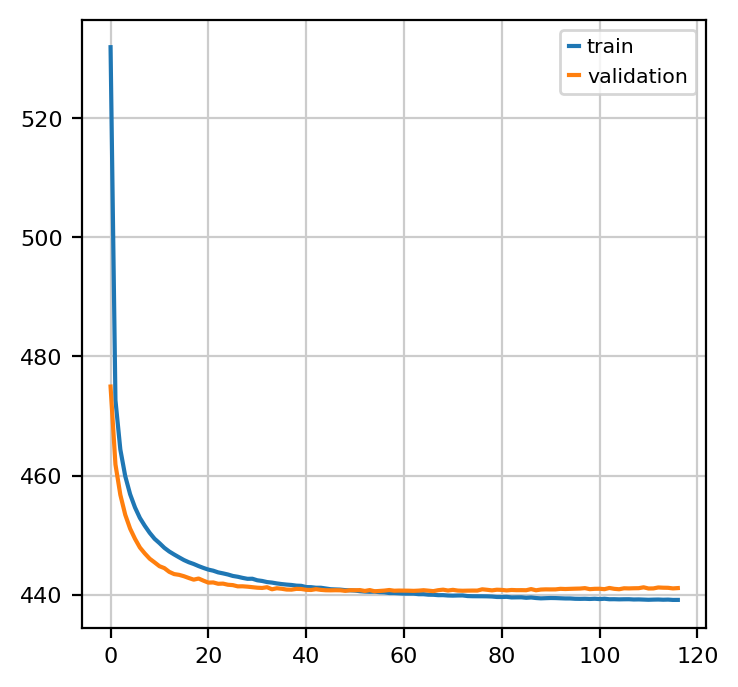

In [30]:
# Plot elbow
plt.plot(model_scvi.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train');
plt.plot(model_scvi.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation');
plt.legend()

In [31]:
# Get latent representation
adata_scvi.obsm["X_scVI"] = model_scvi.get_latent_representation()

Plot integrated UMAP

In [ ]:
sc.pp.neighbors(adata_scvi, use_rep="X_scVI") # use X_scVI as rep
sc.tl.umap(adata_scvi)

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


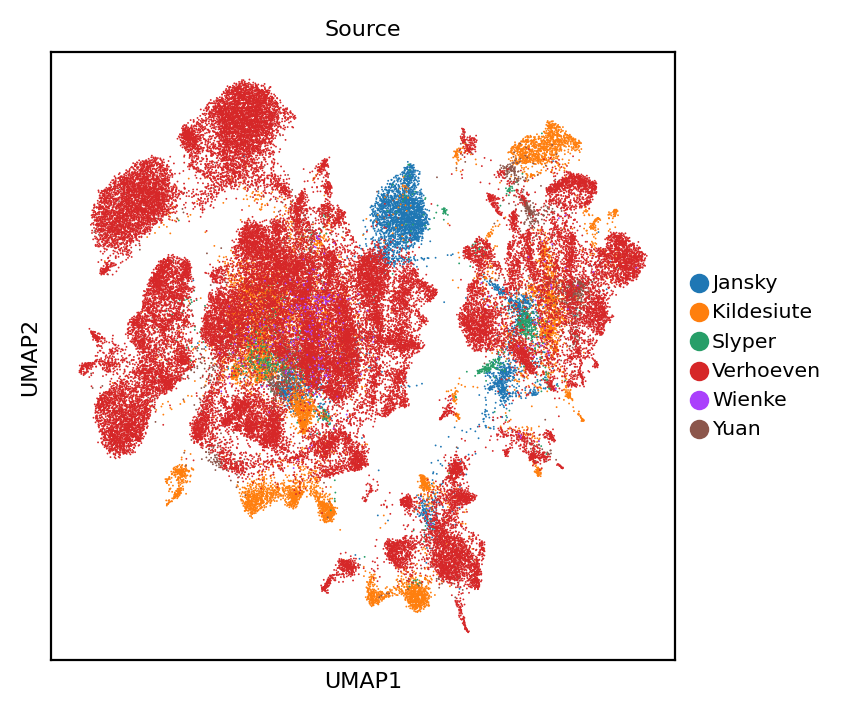

In [49]:
sc.pl.umap(adata_scvi, color=['Source']) #, save='Integrated_UMAP_scVI.png') 

In [81]:
rainbow = sns.color_palette("husl", 8)
rainbow

[(0.9677975592919913, 0.44127456009157356, 0.5358103155058701),
 (0.8087954113106306, 0.5634700050056693, 0.19502642696727285),
 (0.5920891529639701, 0.6418467016378244, 0.1935069134991043),
 (0.19783576093349015, 0.6955516966063037, 0.3995301037444499),
 (0.21044753832183283, 0.6773105080456748, 0.6433941168468681),
 (0.22335772267769388, 0.6565792317435265, 0.8171355503265633),
 (0.6423044349219739, 0.5497680051256467, 0.9582651433656727),
 (0.9603888539940703, 0.3814317878772117, 0.8683117650835491)]

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


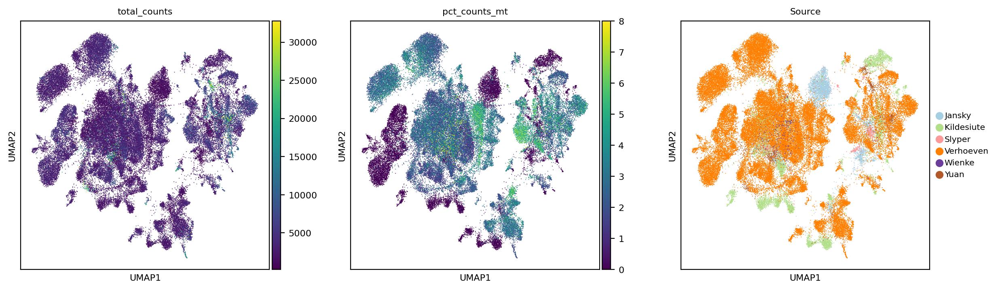

In [100]:
# Plot according to total counts, source and pct mt

# mpl.rcParams["axes.prop_cycle"]

sc.pl.umap(adata_scvi, color=["total_counts", "pct_counts_mt", 'Source'], palette='Paired', save='_immune_cluster_quality_plots_integrated.png')


In [41]:
# Cluster at default first
    # Default was too many clusters
    # 0.1 is too few
    # 
sc.tl.leiden(adata, key_added='leiden_res_default')

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/an

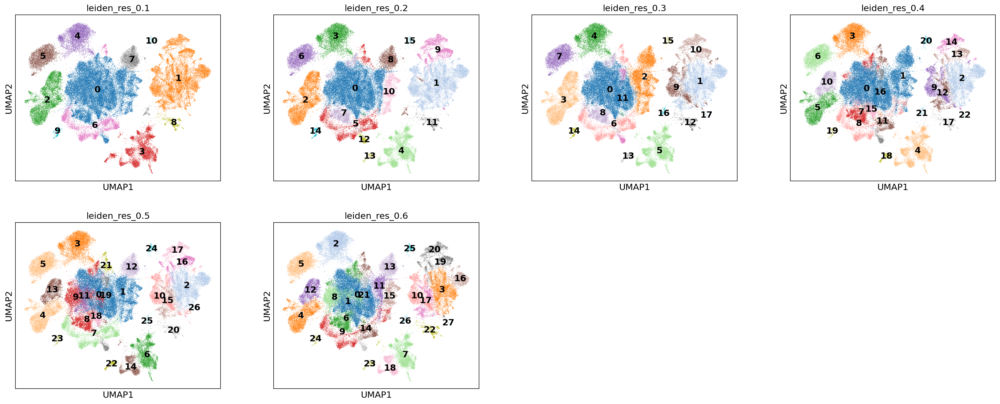

In [129]:
# Plotting to check
sc.pl.umap(
    adata_scvi,
    color=['leiden_res_0.1', 'leiden_res_0.2', 'leiden_res_0.3', 'leiden_res_0.4', 'leiden_res_0.5', 'leiden_res_0.6'],
    palette='tab20',
    legend_loc="on data",
)

In [148]:
# Plot ASW
resolutions = ['leiden_res_0.1', 'leiden_res_0.2', 'leiden_res_0.3', 'leiden_res_0.4', 'leiden_res_0.5']
new_resolutions = ['leiden_res_0.7']

#scores = {}
for i in new_resolutions:
    print(f'Calculating ASW for {i}')
    assignments = adata_scvi.obs[i]
    asw_score = silhouette_score(adata_scvi.obsm['X_scVI'], assignments)
    scores[i] = asw_score
    print(asw_score)
print(scores)

Calculating ASW for leiden_res_0.7
0.1314863
{'leiden_res_0.1': 0.09194192, 'leiden_res_0.2': 0.09716969, 'leiden_res_0.3': 0.10594678, 'leiden_res_0.4': 0.116653144, 'leiden_res_0.5': 0.13407254, 'leiden_res_0.6': 0.13581684, 'leiden_res_0.7': 0.1314863}


In [149]:
# Save scores for using X_scVI layer and save adata
adata_scvi.uns['asw_scvi'] = scores

adata_scvi.write('/project/data/gew123/Cell_Annotation/immune_subset_figures/scvi_integrated_immune_subset.h5ad')

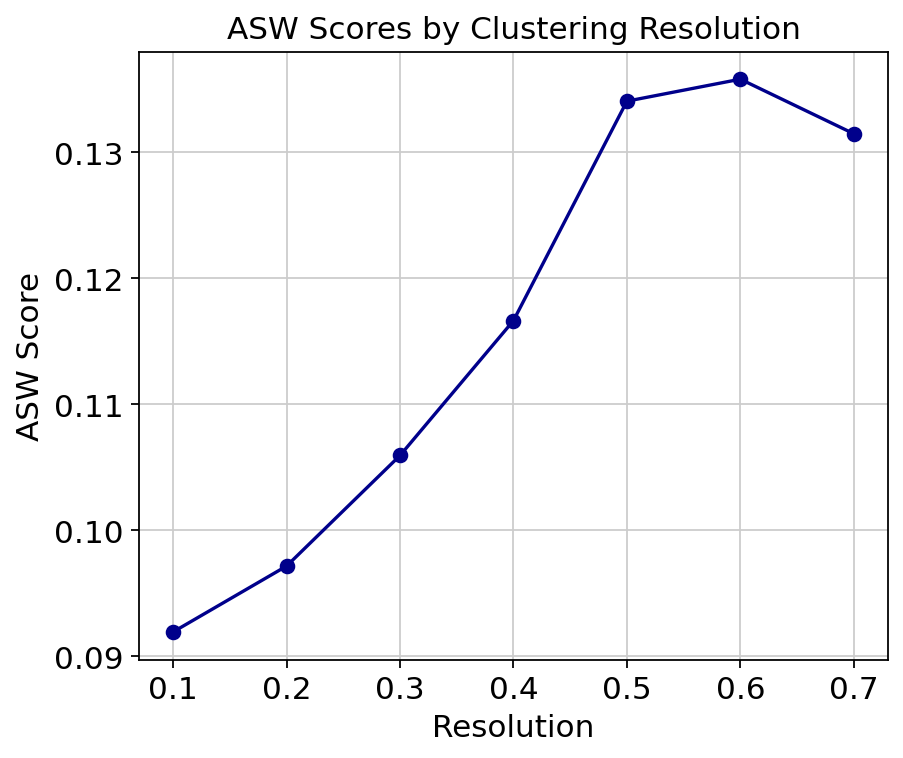

In [151]:
# Plot
sc.set_figure_params(scanpy=True, dpi=80, figsize=(6,5), dpi_save=400)
resolutions = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7]

plt.plot(resolutions, scores.values(), marker='o', color='darkblue')
plt.title("ASW Scores by Clustering Resolution")
plt.xlabel("Resolution")
plt.ylabel("ASW Score")
plt.savefig('/project/data/gew123/Cell_Annotation/immune_subset_figures/asw_plot_integrated_clusterings.png')
plt.show()

In [243]:
# Also save adata object just in case
adata_scvi.write('/project/data/gew123/Cell_Annotation/immune_subset_figures/scvi_integrated_immune_subset.h5ad')

Lets try getting top 5 DEGs for resolution 5

In [230]:
# I want to see if the neuronal cells in the other UMAP project onto the batch corrected UMAP in a single cluster

# Get cells in neuronal cluster 
neuronal = adata.obs[adata.obs['leiden_res_0.7'] == '12']

# df.index returns cell names

# Change their label in adata_scvi
copy_adata_scvi = adata_scvi.copy()

# Changing labels
cluster12 = copy_adata_scvi.obs.loc[neuronal.index,:]
rows = cluster12.index.to_list()

# Set as category in manual_labels
if 'Neuronal/glial cells' not in copy_adata_scvi.obs['manual_labels'].cat.categories:
    copy_adata_scvi.obs['manual_labels'] = copy_adata_scvi.obs['manual_labels'].cat.add_categories('Neuronal/glial cells')

# Now change
copy_adata_scvi.obs.loc[rows, 'manual_labels'] = 'Neuronal/glial cells'

Now plot

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


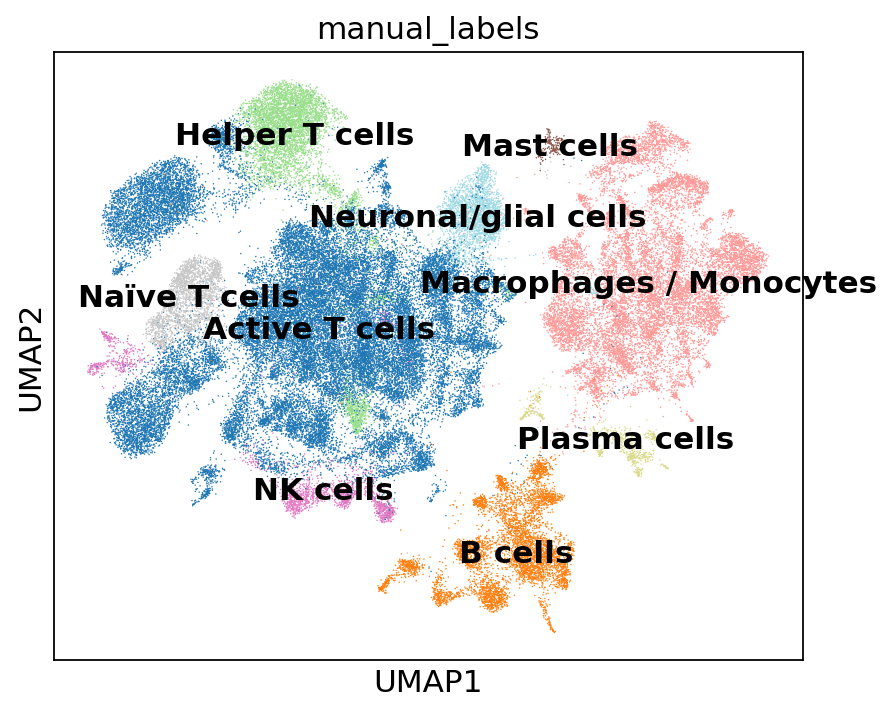

In [231]:
sc.pl.umap(
    copy_adata_scvi,
    color=['manual_labels'],
    palette='tab20',
    legend_loc="on data",
)

# Looks good, so let's use this UMAP at resolution 6

In [234]:
# Reset manual labs
adata_scvi.obs['manual_labels'] = adata.obs['manual_labels']

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


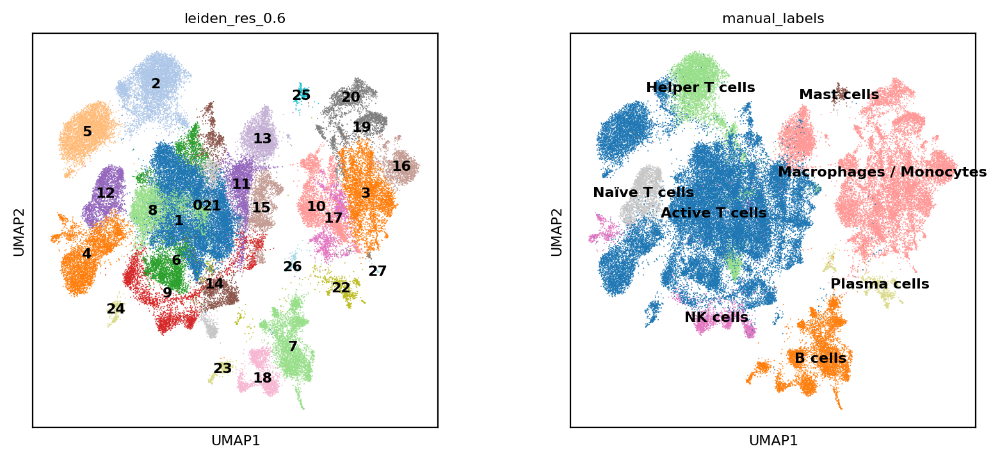

In [244]:
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8, figsize=(4,4))

sc.pl.umap(
    adata_scvi,
    color=['leiden_res_0.6', 'manual_labels'],
    palette='tab20',
    legend_loc="on data",
    save='_integrated_clustered_and_labels_immune_subset.png'
)

### Now repeating manual annotation steps for integrated data:

Label clusters by DEGs

In [6]:
# Supplement annotation by dot plot of cluster DEGS
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'

# Calculate DEGs
sc.tl.rank_genes_groups(
    adata_scvi, groupby="leiden_res_0.6", method="wilcoxon", key_added="dea_leiden_0.6"
)

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Li

In [7]:
# Save with dea stored
adata_scvi.write('/project/data/gew123/Cell_Annotation/immune_subset_figures/scvi_integrated_immune_subset.h5ad')

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


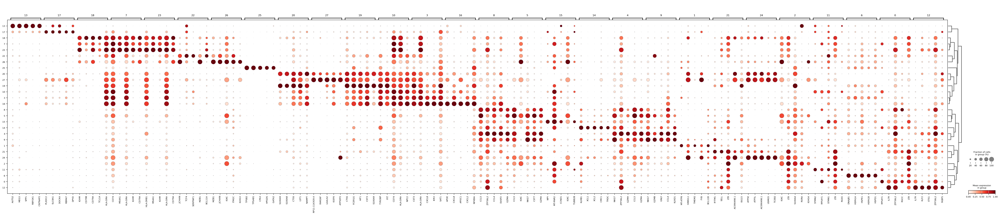

In [246]:
# Visualize DEGs as dot plot
sc.pl.rank_genes_groups_dotplot(
    adata_scvi, groupby="leiden_res_0.6", standard_scale="var", n_genes=5, key="dea_leiden_0.6",
    save='immune_subset_deg_dotplot_integrated.png'
)

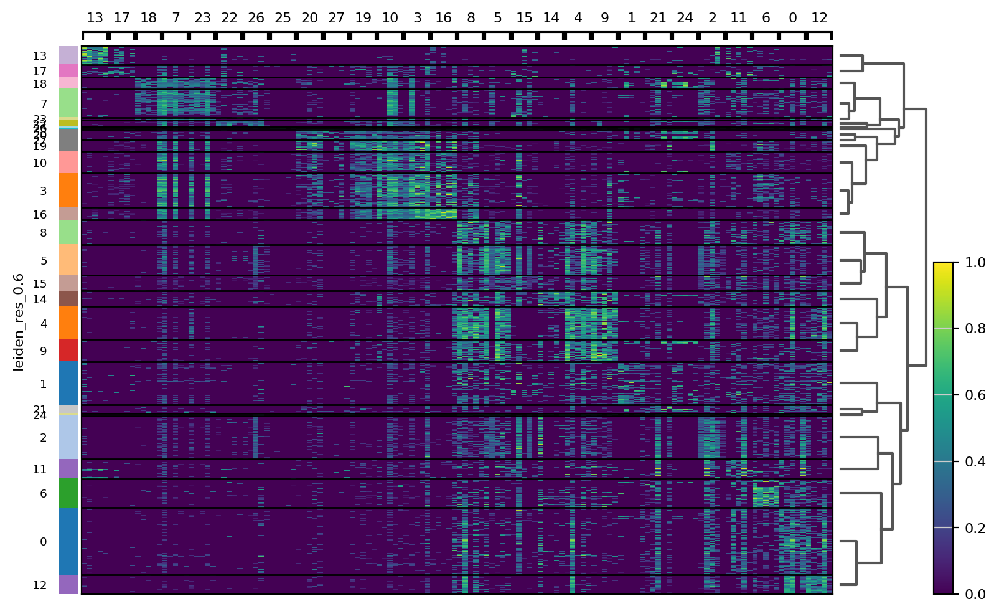

In [247]:
# Visualize DEGs as heat map
sc.pl.rank_genes_groups_heatmap(
    adata_scvi, groupby="leiden_res_0.6", standard_scale="var", n_genes=5, key="dea_leiden_0.6",
    save='immune_subset_deg_heatmap_integrated.png'
)

In [2]:
adata_scvi = sc.read_h5ad('/project/data/gew123/Cell_Annotation/immune_subset_figures/scvi_integrated_immune_subset.h5ad')

In [29]:
# Convert and sort
clusters = list(adata.obs['leiden_res_0.6'].unique())

for index, i in enumerate(clusters):
    clusters[index] = int(i)

clusters.sort()

In [30]:
# Access the results stored in 'uns' attribute
degs_results = adata.uns['dea_leiden_0.6']

for i in clusters:

    # Get the names of the top 5 genes for the specified cluster
    print(f'Cluster {i}:', list(degs_results['names'][f'{i}'][:5]))

Cluster 0: ['RPS4Y1', 'IL7R', 'ZFP36L2', 'RGCC', 'LTB']
Cluster 1: ['MT-ATP8', 'GNB2L1', 'TMEM2', 'FYB', 'BCL11B']
Cluster 2: ['IGKC', 'LTB', 'S100A4', 'RORA', 'IGHG4']
Cluster 3: ['CST3', 'HLA-DRA', 'CXCL8', 'IER3', 'SAT1']
Cluster 4: ['NKG7', 'ZFP36L2', 'GZMH', 'CCL5', 'GZMA']
Cluster 5: ['CCL5', 'IGKC', 'NKG7', 'CST7', 'GZMA']
Cluster 6: ['DNAJB1', 'HSPA1A', 'HSPE1', 'HSPA1B', 'HSPD1']
Cluster 7: ['CD74', 'MS4A1', 'HLA-DRA', 'IGHM', 'CD79A']
Cluster 8: ['CCL5', 'ZFP36L2', 'CCL4', 'DUSP2', 'GZMA']
Cluster 9: ['NKG7', 'GZMB', 'GNLY', 'CCL4', 'KLRD1']
Cluster 10: ['TYROBP', 'LYZ', 'CD74', 'HLA-DRA', 'NPC2']
Cluster 11: ['STMN2', 'RPS4Y1', 'STMN1', 'LTB', 'RGS5']
Cluster 12: ['IL7R', 'KLF2', 'ETS1', 'ZFP36L2', 'FKBP5']
Cluster 13: ['AUTS2', 'MEG3', 'SPP1', 'RBFOX1', 'CNTNAP2']
Cluster 14: ['KLRB1', 'XCL1', 'XCL2', 'CMC1', 'TRDC']
Cluster 15: ['NPY', 'MT-RNR2', 'CCND1', 'IGKC', 'TUBB2B']
Cluster 16: ['APOE', 'CXCL8', 'APOC1', 'CXCL2', 'NFKBIA']
Cluster 17: ['PLXDC2', 'SLC8A1', 'DOCK4', '

In [67]:
# Get top 10 DEGs
i = 15
print(f'Cluster {i}:', list(degs_results['names'][f'{i}'][:20]))

Cluster 15: ['NPY', 'MT-RNR2', 'CCND1', 'IGKC', 'TUBB2B', 'STMN1', 'IGHA1', 'MDK', 'IGLC3', 'CCL5', 'IL32', 'HSPE1', 'CD69', 'TUBA4A', 'CST7', 'STMN2', 'DBH', 'RGS1', 'CEMIP2', 'CCL4']


In [ ]:
import matplotlib as mpl

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


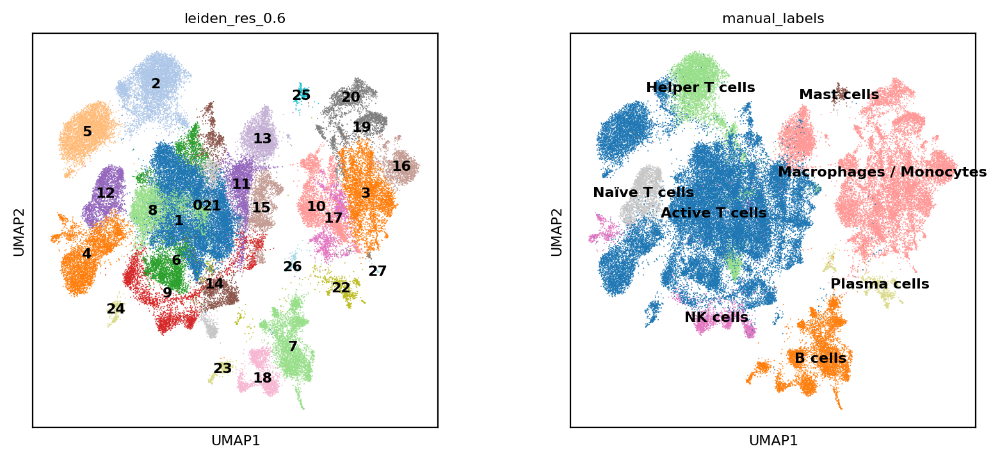

In [102]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8, figsize=(4,4))

sc.pl.umap(
    adata_scvi,
    color=['leiden_res_0.6', 'manual_labels'],
    palette='tab20',
    legend_loc="on data",
)

Supplement labels with marker gene plots

In [25]:
# First we need to expand the gene set back to all 29k
adata = sc.read_h5ad('/project/data/gew123/Cell_Annotation/immune_cell_subset_clustered.h5ad')

In [28]:
# Delete old clusterings
del adata.obs['leiden_res_0.4']
del adata.obs['leiden_res_0.5']
del adata.obs['leiden_res_0.6']
del adata.obs['leiden_res_default']

# Rename old 0.7 clustering to not get confused with new
adata.obs['leiden_res_0.7_old'] = adata.obs['leiden_res_0.7']
del adata.obs['leiden_res_0.7']

In [30]:
uns_to_delete = ['leiden', 'leiden_res0.9_colors', 'leiden_res_0.1_colors', 'leiden_res_0.2_colors', 'leiden_res_0.3_colors', 'leiden_res_0.4_colors',
             'leiden_res_0.5_colors', 'leiden_res_0.6_colors',]

for i in uns_to_delete:
    del adata.uns[i]

In [36]:
# Transfer UMAP profile, Scvi embeddings and the adata.obs from integrated to original (keeping 64k genes)
adata.obsm['X_pca'] = adata_scvi.obsm['X_pca']
adata.obsm['X_umap'] = adata_scvi.obsm['X_umap']
adata.obsm['X_scVI'] = adata_scvi.obsm['X_scVI']

# Transfer color maps
adata.uns = adata_scvi.uns

# Transfer cluster assignment col
adata.obs['leiden_res_0.6'] = adata_scvi.obs['leiden_res_0.6']

In [57]:
# Save
adata.write('/project/data/gew123/Cell_Annotation/immune_subset_figures/integrated_immune_subset_ALLGENES.h5ad')

In [2]:
# checkpoint
adata = sc.read_h5ad('/project/data/gew123/Cell_Annotation/immune_subset_figures/integrated_immune_subset_ALLGENES.h5ad')

Plot marker genes

Neuroblasts:


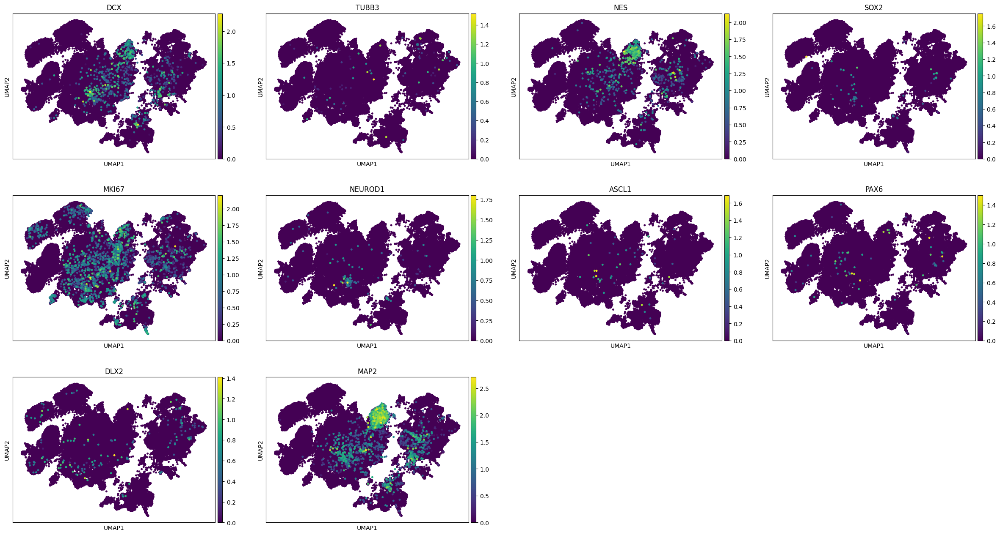

Sympathoblasts:


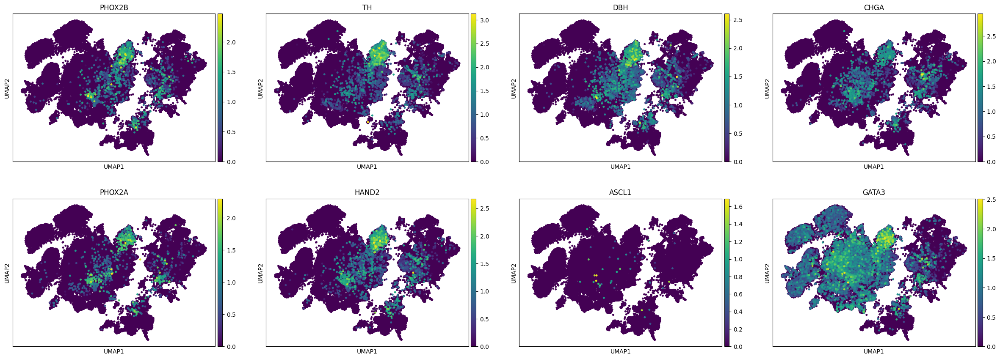

Sympathetic neurons:


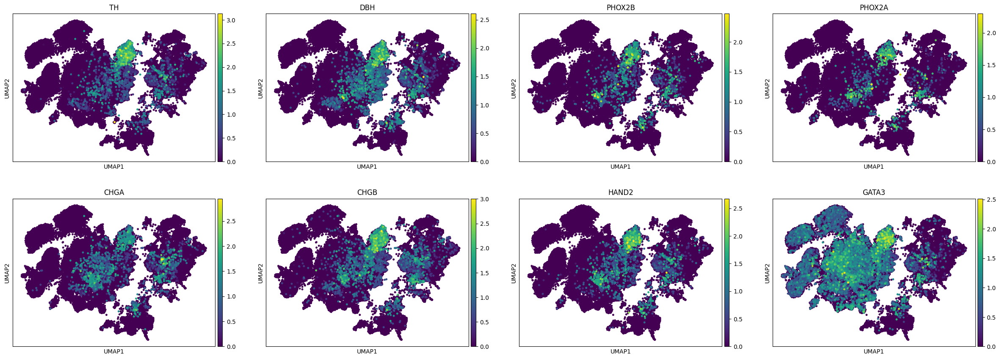

Glial cells:


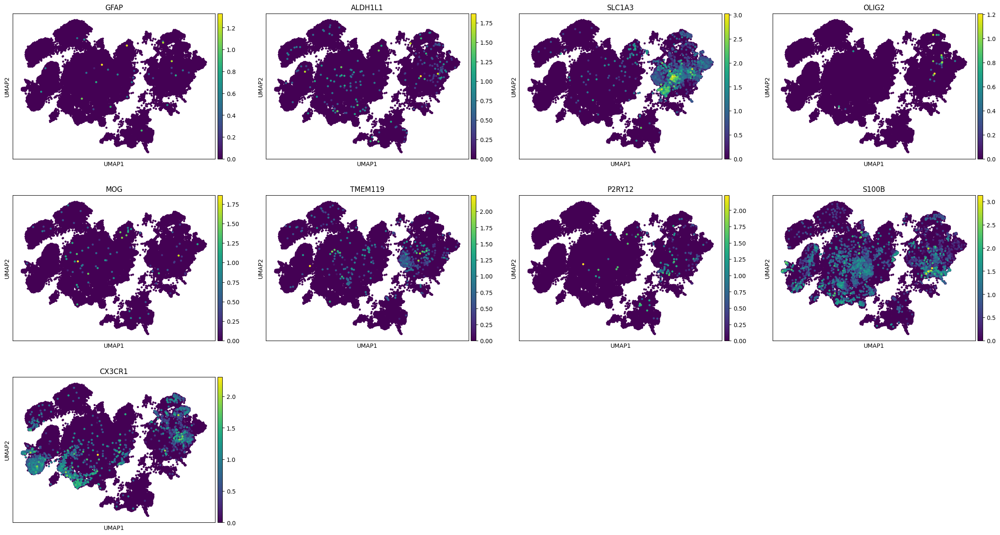

In [66]:
import scanpy as sc
import matplotlib.pyplot as plt

# Define marker genes for sympathoblasts and neuroblasts
sympathoblast_markers = ['PHOX2B', 'TH', 'DBH', 'CHGA', 'PHOX2A', 'HAND2', 'ASCL1', 'GATA3']
neuroblast_markers = ['DCX', 'TUBB3', 'NES', 'SOX2', 'MKI67', 'NEUROD1', 'ASCL1', 'PAX6', 'DLX2', 'MAP2']
neuron_markers = ['TH', 'DBH', 'PHOX2B', 'PHOX2A', 'CHGA', 'CHGB', 'HAND2', 'GATA3']
glial_markers = [
    'GFAP',     # Astrocytes
    'ALDH1L1',  # Astrocytes
    'SLC1A3',   # Astrocytes
    'OLIG2',    # Oligodendrocytes
    'MOG',      # Oligodendrocytes
    'TMEM119',  # Microglia
    'P2RY12',   # Microglia
    'S100B',    # Astrocytes and Schwann cells
    'Nestin',   # Neural stem cells and reactive gliosis
    'CX3CR1',   # Microglia
]

# Combine markers for plotting
all_markers = sympathoblast_markers + neuroblast_markers

# Check if these markers are in your dataset
nb_in_data = [gene for gene in neuroblast_markers if gene in adata.var_names]
sympatho_in_data = [gene for gene in sympathoblast_markers if gene in adata.var_names]
neuron_in_data = [gene for gene in neuron_markers if gene in adata.var_names]
glial_in_data = [gene for gene in glial_markers if gene in adata.var_names]

# Plot the expression of these markers on the UMAP
print('Neuroblasts:')
sc.pl.umap(adata, color=nb_in_data, s=50, cmap='viridis', ncols=4)
print('Sympathoblasts:')
sc.pl.umap(adata, color=sympatho_in_data, s=50, cmap='viridis', ncols=4)
print('Sympathetic neurons:')
sc.pl.umap(adata, color=neuron_in_data, s=50, cmap='viridis', ncols=4, save='_sympathetic_neuron_markers.png')
print('Glial cells:')
sc.pl.umap(adata, color=glial_in_data, s=50, cmap='viridis', ncols=4)

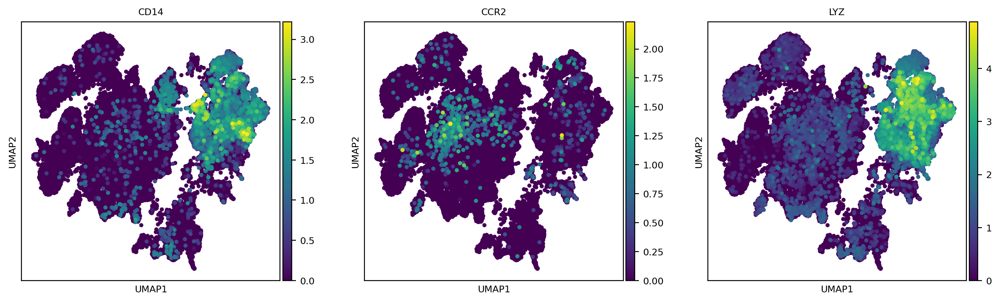

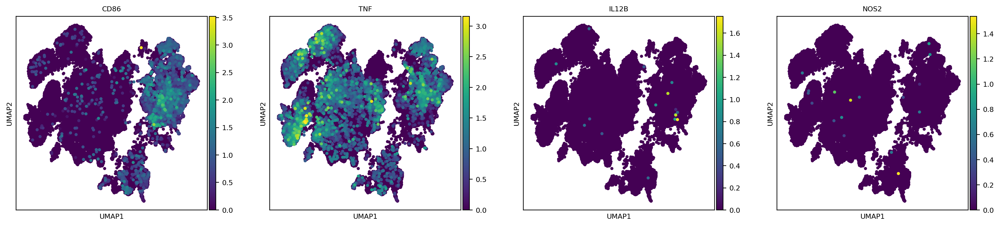

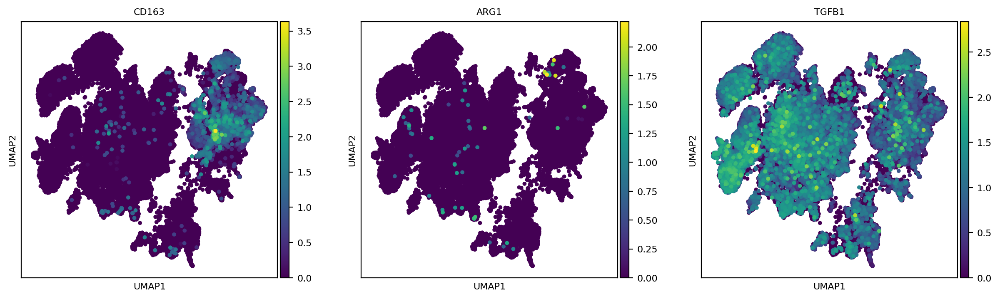

In [77]:
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

import scanpy as sc
import matplotlib.pyplot as plt

# Define marker genes for monocytes and macrophages
monocyte_markers = ['CD14', 'CD16', 'CCR2', 'LYZ']
m1_markers = ['CD86', 'TNF', 'IL12B', 'NOS2']
m2_markers = ['CD163', 'CD206', 'ARG1', 'TGFB1']

# Combine markers for plotting
all_markers = monocyte_markers + macrophage_markers

# Check if these markers are in your dataset
macro1_in_data = [gene for gene in m1_markers if gene in adata.var_names]
macro2_in_data = [gene for gene in m2_markers if gene in adata.var_names]
mono_in_data = [gene for gene in monocyte_markers if gene in adata.var_names]

# Plot the expression of these markers on the UMAP
sc.pl.umap(adata, color=mono_in_data, s=50, cmap='viridis', ncols=4)
sc.pl.umap(adata, color=macro1_in_data, s=50, cmap='viridis', ncols=4)
sc.pl.umap(adata, color=macro2_in_data, s=50, cmap='viridis', ncols=4)

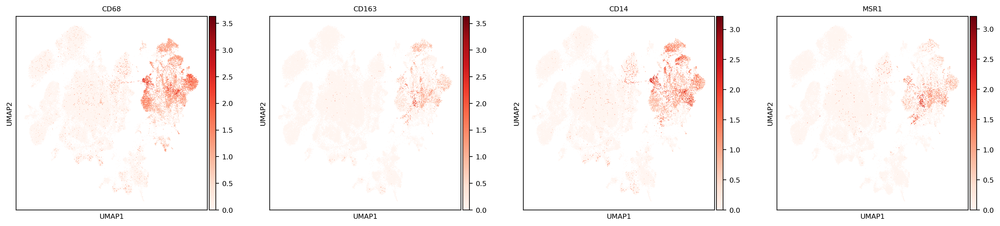

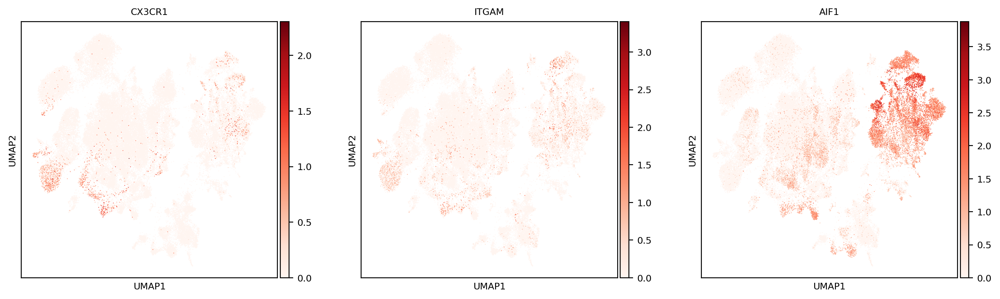

In [83]:
sc.pl.umap(adata, color=['CD68', 'CD163', 'CD14', 'MSR1'], cmap='Reds')#, save='_cyto_tcell_markers.png')
sc.pl.umap(adata, color=['CX3CR1', 'ITGAM', 'AIF1'], cmap='Reds')#, save='_cyto_tcell_markers.png')


Naive cell markers:


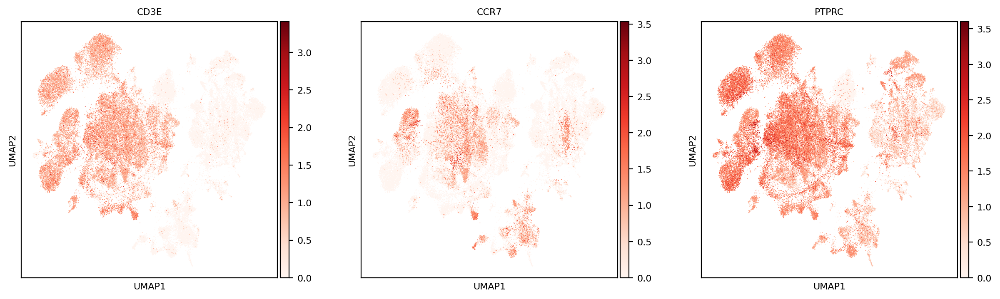

Diff cell markers:


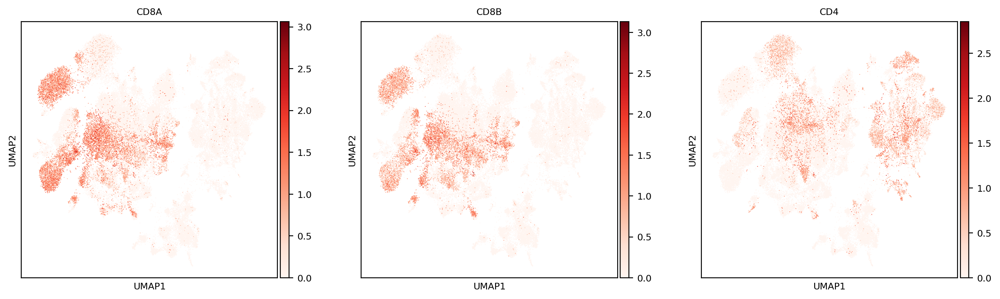

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


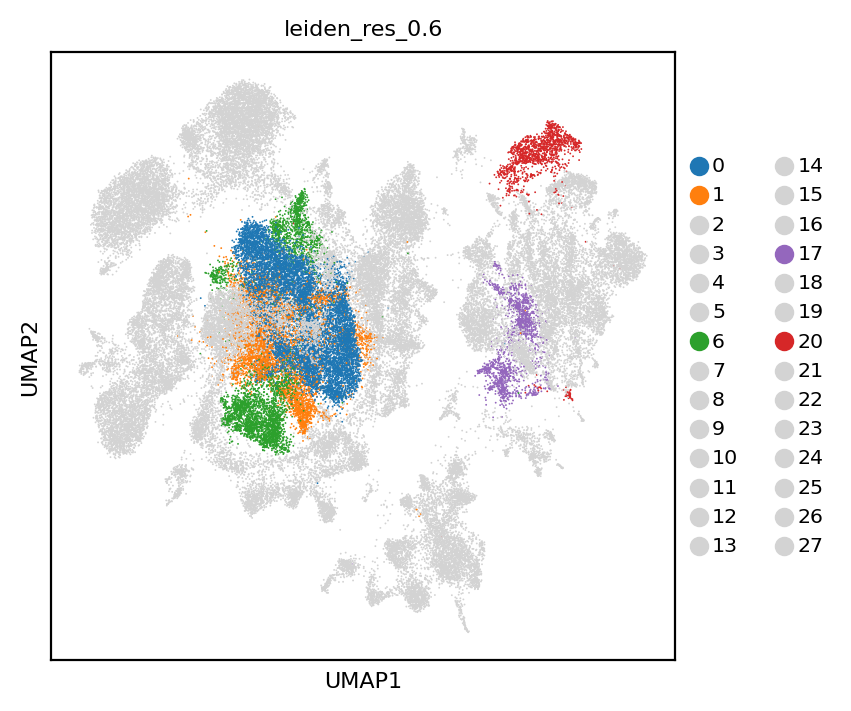

In [43]:
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

print('Naive cell markers:')
sc.pl.umap(adata, color=['CD3E','CCR7', 'PTPRC'], cmap='Reds')#, save='_cyto_tcell_markers.png')
print('Diff cell markers:')
sc.pl.umap(adata, color=['CD8A', 'CD8B', 'CD4'], cmap='Reds')#, save='_cyto_tcell_markers.png')

clusters_to_highlight = ['0', '1', '6', '20', '17']
colors_to_plot = {cluster: plt.cm.tab10(i) for i, cluster in enumerate(clusters_to_highlight)}
colors_to_plot.update({cluster: 'lightgrey' for cluster in np.unique(adata.obs['leiden_res_0.6']) if cluster not in clusters_to_highlight})

sc.pl.umap(
    adata,
    color='leiden_res_0.6',
    palette=colors_to_plot,
  #  legend_loc="on data",
)



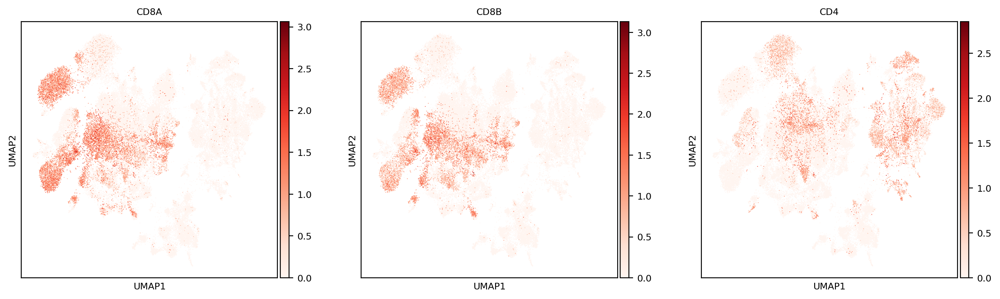

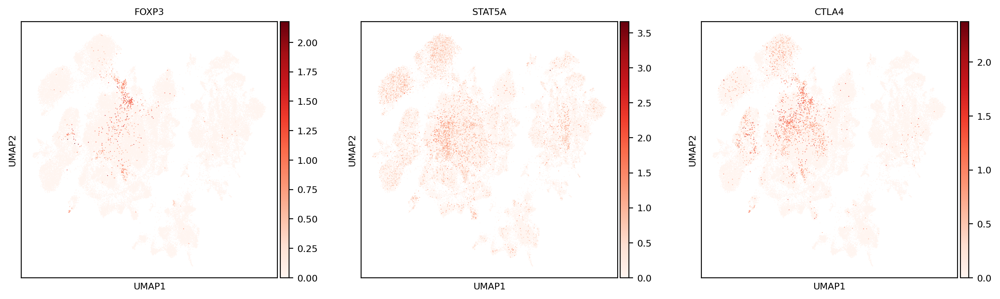

In [202]:
sc.pl.umap(adata, color=['CD8A', 'CD8B', 'CD4'], cmap='Reds')#, save='_nk_markers.png')
sc.pl.umap(adata, color=['FOXP3', 'STAT5A', 'CTLA4'], cmap='Reds')#, save='_cyto_tcell_markers.png')



In [12]:
# Specific cell markers
markers_specific = {
    'Tregs' : ['FOXP3', 'STAT5A', 'CTLA4'],
    'Cytotoxic (CD8+) T cells' : ['CD8A', 'CD8B', 'CD28', 'CD3E'],
    'Helper (CD4+) T cells' : ['CD4', 'CD3E'],
    'Macrophages' : ['CD68', 'CD163', 'CD14'], 
    'B cells' : ['CD19', 'IGHD', 'IGHM', 'TCL1A', 'MS4A1', 'CD79A'], # MS4A1 = CD20
    'Plasma cells' : ['PRDM1', 'SDC1', 'CD38'], # SDC1 = CD138
    'NK cells' : ['NCAM1'] # NCAM1 = CD56 # Check if CD16 and CD57 are in data

}

# General cell markers
markers_general = {'Myeloid cells' : ['CST3'],
           'T cells' : ['CD3E', 'CD3D', 'CD3G', 'CD28', 'CD69', 'CX3CR1']
          }

# Turn into a single list
markers_list = []
for key, val in markers_specific.items():
    for i in val:
        markers_list.append(i)
markers_list

['FOXP3',
 'STAT5A',
 'CTLA4',
 'CD8A',
 'CD8B',
 'CD28',
 'CD3E',
 'CD4',
 'CD3E',
 'CD68',
 'CD163',
 'CD14',
 'CD19',
 'IGHD',
 'IGHM',
 'TCL1A',
 'MS4A1',
 'CD79A',
 'PRDM1',
 'SDC1',
 'CD38',
 'NCAM1']

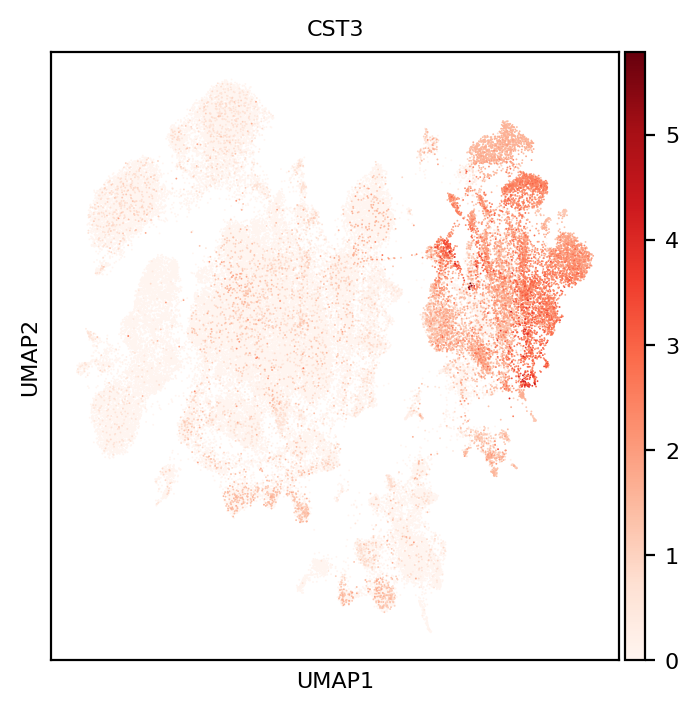

In [9]:
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

sc.pl.umap(adata, color=['CST3'], cmap='Reds', save='_myeloid_markers.png')

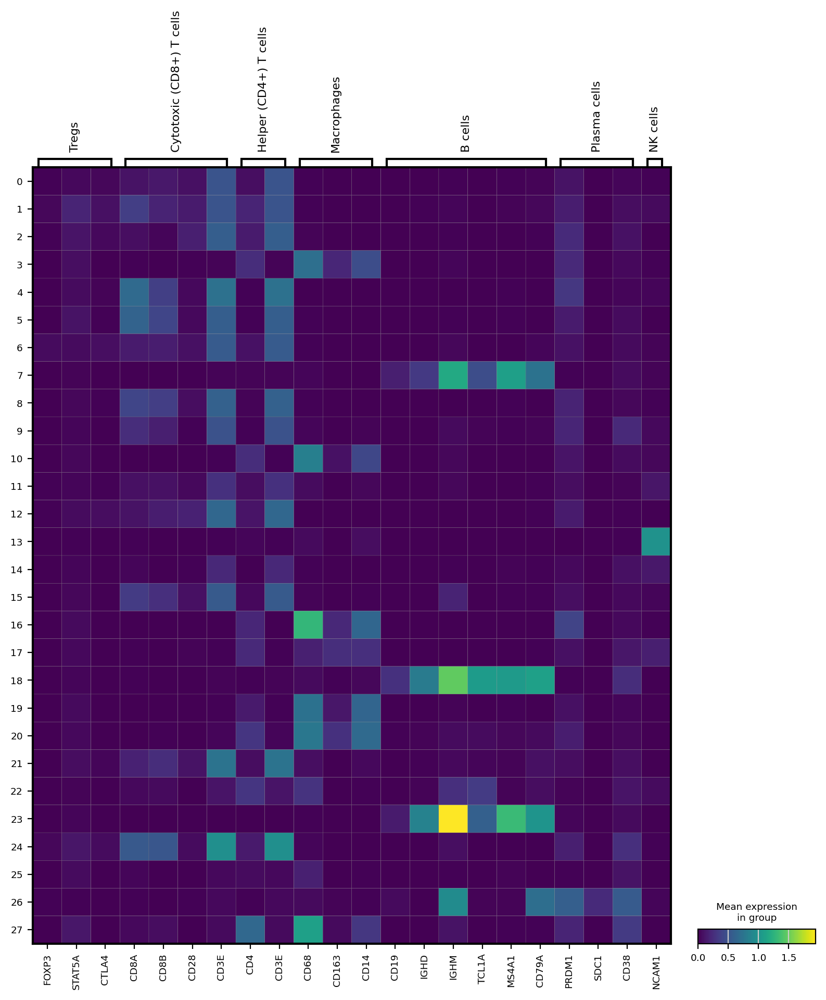

In [17]:
# Plot a matrixplot
fig = sc.pl.matrixplot(adata, markers_specific, groupby='leiden_res_0.6', cmap='viridis', return_fig=True)
fig.savefig('/project/data/gew123/Cell_Annotation/immune_subset_figures/marker_matrixplot.png')

#mp.add_totals().style(edge_color='black').show()

In [204]:
# Update annotations
new_annotations = {
    0: 'Naïve T cells',
    1: 'Cytotoxic (CD8+) T cells',
    2: 'Helper (CD4+) T cells',
    3: 'Macrophages/monocytes',
    4: 'Cytotoxic (CD8+) T cells',
    5: 'Cytotoxic (CD8+/IGKC+) T cells',
    6: 'Naïve T cells',
    7: 'B cells',
    8: 'Cytotoxic (CD8+) T cells',
    9: 'NK cells',
    10: 'Macrophages/monocytes',
    11: 'Sympathetic neurons',
    12: 'Naïve T cells',
    13: 'Sympathetic neurons',
    14: 'NK cells',
    15: 'Proliferating T cells',
    16: 'Macrophages/monocytes',
    17: 'Sympathetic neuronal/glial cells',
    18: 'B cells',
    19: 'Macrophages/monocytes',
    20: 'Macrophages/monocytes',
    21: 'Cytotoxic (CD8+) T cells',
    22: 'Plasma cells',
    23: 'B cells',
    24: 'Cytotoxic (CD8+) T cells',
    25: 'Mast cells',
    26: 'Plasma cells',
    27: 'Macrophages/monocytes'
}

In [205]:
# Create column with new labels
for cluster, new_label in new_annotations.items():
    cluster = str(cluster)
    if cluster in adata.obs['leiden_res_0.6'].unique():
        adata.obs.loc[adata.obs['leiden_res_0.6'] == cluster, 'manual_labels_new'] = new_label

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


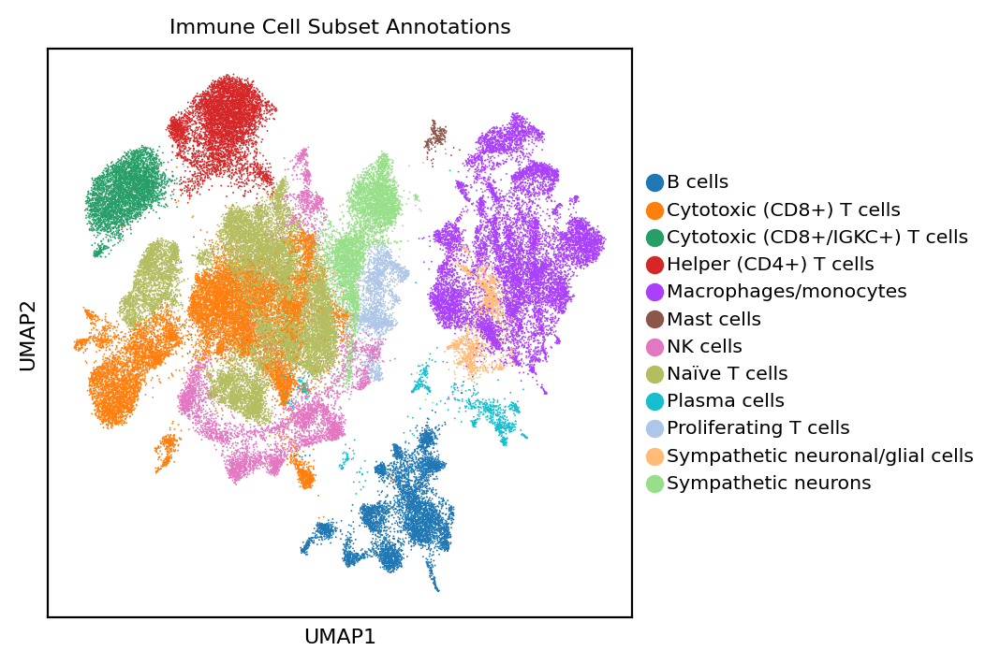

In [10]:
# Plot new labels
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/Figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8, figsize=(4,4))

sc.pl.umap(
    adata,
    color=['manual_labels_new'],
    title='Immune Cell Subset Annotations',
    palette=plt.rcParams["axes.prop_cycle"],
    #legend_loc="on data",
    save='_immune_subset_annotated_final.png'
)

In [141]:
# Check categories
adata.obs['manual_labels'].cat.categories

Index(['Active T cells', 'B cells', 'Helper T cells',
       'Macrophages / Monocytes', 'Mast cells', 'NK cells', 'Naïve T cells',
       'Plasma cells', 'Cytotoxic (CD8+) T cells', 'Macrophages/monocytes',
       'Helper (CD4+) T cells)'],
      dtype='object')

In [207]:
# Save the final object!
adata.write('/project/data/gew123/Cell_Annotation/immune_cell_subset_annotated_ALLGENES_FINAL.h5ad')

In [ ]:
# add new categories
new_category = 'Cytotoxic (CD8+) T cells'
adata.obs['manual_labels'] = adata.obs['manual_labels'].cat.add_categories(new_category)

In [ ]:
new_category = 'Macrophages/monocytes'
adata.obs['manual_labels'] = adata.obs['manual_labels'].cat.add_categories(new_category)

In [136]:
new_category = 'Helper (CD4+) T cells)'
adata.obs['manual_labels'] = adata.obs['manual_labels'].cat.add_categories(new_category)

In [138]:
# Get manual_labels for cluster 2
cluster2 = adata.obs['leiden_res_0.6'] == '2'

for index, label in adata.obs.loc[cluster2, 'manual_labels'].items():
    if label == 'Active T cells':
        # Update the label to 'Cytotoxic (CD8+) T cells'
        adata.obs.at[index, 'manual_labels'] = 'Cytotoxic (CD8+) T cells'
    if label == 'Macrophages / Monocytes':
        adata.obs.at[index, 'manual_labels'] = 'Helper (CD4+) T cells)'
    if label == 'Helper T cells':
        adata.obs.at[index, 'manual_labels'] = 'Helper (CD4+) T cells)'

In [147]:
# Set matching categories:
column1 = test.obs['manual_labels']
column2 = test.obs['manual_labels_new']

# Identify unique categories from both columns
categories_union = set(column1.cat.categories) | set(column2.cat.categories)

# Convert both columns to categorical with identical categories
column1 = pd.Categorical(column1, categories=categories_union)
column2 = pd.Categorical(column2, categories=categories_union)

# Update the columns in the AnnData object
test.obs['manual_labels'] = column1
test.obs['manual_labels_new'] = column2

In [149]:
# Check if categories are the same for both columns
categories_equal = (test.obs['manual_labels'].cat.categories == test.obs['manual_labels_new'].cat.categories).all()

if categories_equal:
    print("Categories are the same for both columns.")
else:
    print("Categories are different for both columns.")

Categories are the same for both columns.


In [151]:
# Define the shared categories based on existing columns or manually
shared_categories = adata.obs['manual_labels'].cat.categories

# Set identical categories for both columns
adata.obs['manual_labels'] = adata.obs['manual_labels'].cat.set_categories(shared_categories)
adata.obs['manual_labels_new'] = adata.obs['manual_labels_new'].cat.set_categories(shared_categories)

In [2]:
adata = sc.read_h5ad('/project/data/gew123/Cell_Annotation/immune_cell_subset_annotated_ALLGENES_FINAL.h5ad')

### Unintegrated clustering / annotation starts here!

Preprocessing and feature selection

In [68]:
# Preprocess the subset
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=4000)

In [42]:
adata

AnnData object with n_obs × n_vars = 68383 × 29392
    obs: 'Source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'leiden_res0.7', 'leiden_res0.9', 'manual_labels', 'leiden_res_default', 'leiden_res_0.4', 'leiden_res_0.5', 'leiden_res_0.6', 'leiden_res_0.7', 'leiden_res_0.1'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'Source_colors', '_scvi_manager_uuid', '_scvi_uuid', 'dea_leiden_0.4', 'dea_leiden_0.7', 'dea_leiden_0.9', 'dendrogram_leiden_res0.9', 'dendrogram_leiden_res_0.4

Proceeding without integration:

In [44]:
# PCA
sc.pp.pca(adata)

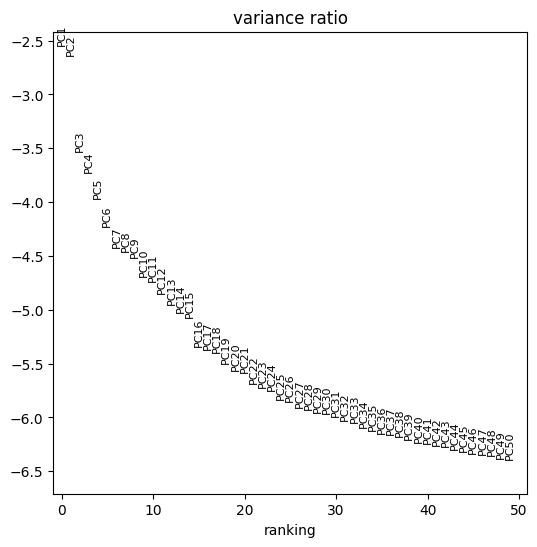

In [71]:
# Elbow plot
plt.rcParams['figure.figsize'] = [6, 6]
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

In [72]:
# Neighbors
sc.pp.neighbors(adata, n_pcs=30)

# UMAP
sc.tl.umap(adata)

2024-07-10 10:35:03.540960: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Testing different clustering resolutions

In [ ]:
del adata.obs ['leiden_res_0.1']
del adata.obs ['leiden_res_0.2']
del adata.obs ['leiden_res_0.3']

Right now 0.4 is too broad, but default is maybe too specific (38 clusters). Trying resolutions between 0.5 and 1.0 to find an optimal cluster number

In [40]:
# Call clustering algorithm
sc.tl.leiden(adata, key_added='leiden_res_0.1', resolution=0.1)

In [16]:
rainbow = sns.color_palette("husl", 27)
rainbow

[(0.9677975592919913, 0.44127456009157356, 0.5358103155058701),
 (0.9696978573362075, 0.4551663970399386, 0.38923232317610296),
 (0.9304308035919827, 0.4946452110565656, 0.19614814632634098),
 (0.8369430560927636, 0.5495828952802333, 0.1952683223448124),
 (0.7664260135079906, 0.5824881150484876, 0.1946820437916013),
 (0.7046380337395199, 0.6066813077197386, 0.19422166070226404),
 (0.6430915736746491, 0.6271955086583126, 0.19381135329796756),
 (0.5732302650189269, 0.6467756531666149, 0.19340233286718894),
 (0.47991068787669294, 0.667685156794303, 0.1929464378244283),
 (0.3126890019504329, 0.6928754610296064, 0.1923704830330379),
 (0.19708980450396424, 0.6965732224236837, 0.37943641856247967),
 (0.20211707629358638, 0.6895678404762577, 0.4976337874725035),
 (0.20582072623426667, 0.6842209016721069, 0.5675558225732941),
 (0.2089572633605319, 0.6795648776973504, 0.6200646838723776),
 (0.21194189869758095, 0.6750221810487371, 0.6659130455541331),
 (0.2151139535594307, 0.6700707833028816, 0.7112365203426209),
 (0.21890722998490392, 0.6639772447164051, 0.7618001114553088),
 (0.22414045127954096, 0.6552494760171351, 0.8264923332995494),
 (0.23299120924703914, 0.639586552066035, 0.9260706093977744),
 (0.453383455012143, 0.602494598022915, 0.9585255365157427),
 (0.6101483803397304, 0.5609057766662903, 0.9583176268954324),
 (0.731751635642941, 0.5128186367840487, 0.9581005178234921),
 (0.8470791154631412, 0.44800041568051846, 0.9578460569897674),
 (0.9581274563609202, 0.3608381860084552, 0.9409666791190804),
 (0.9614880299080136, 0.3909885385134758, 0.8298287106954371),
 (0.963874732347889, 0.41085525854994476, 0.7367459497201602),
 (0.9658388230589939, 0.42640165617286563, 0.6463892001855126)]

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/an

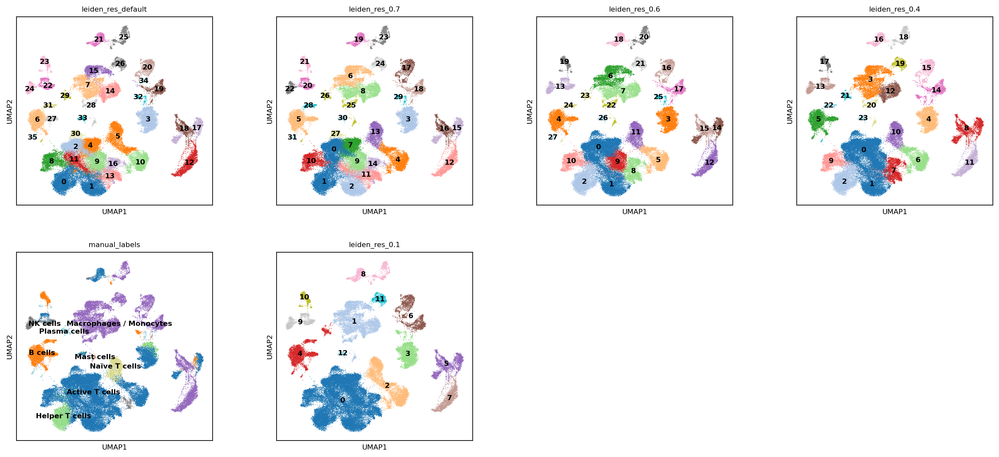

In [41]:
# Plot
sc.pl.umap(
    adata,
    color=['leiden_res_default', 'leiden_res_0.7', 'leiden_res_0.6', 'leiden_res_0.4', 'manual_labels', 'leiden_res_0.1'],
    palette='tab20',
    legend_loc="on data",
)

By visual inspection, resolution 0.7 looks best

In [41]:
colors = (plt.rcParams["axes.prop_cycle"])

In [13]:
new_order = [0, 1, 2, 5, 4, 3, 6, 7]

# Reorder the palette
rainbow = [rainbow[i] for i in new_order]

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


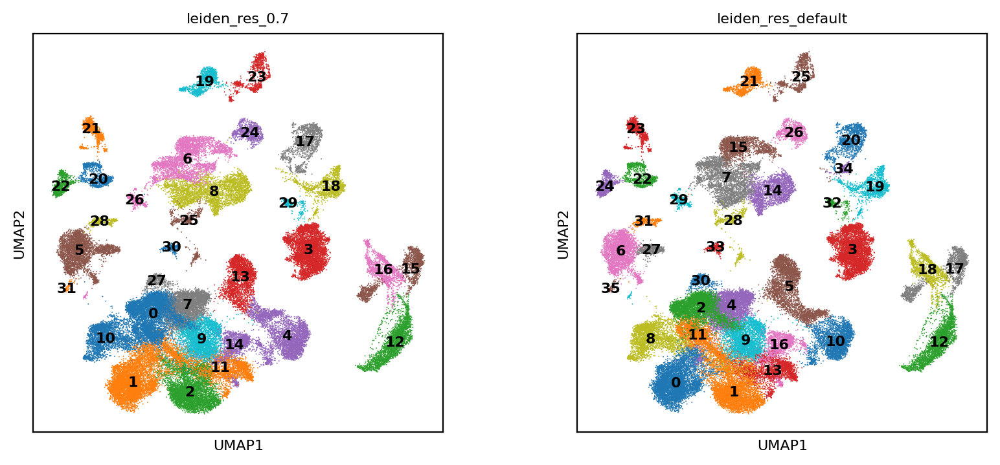

NameError: name 'rainbow' is not defined

In [119]:
# Using 0.4 resolution 
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/Figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

# Plot
sc.pl.umap(
    adata,
    color=['leiden_res_0.7', 'leiden_res_default'],
    palette=colors,
    legend_loc="on data",
    #save='Immune_subset_clusters.png'
)

sc.pl.umap(
    adata,
    color=['manual_labels'],
    palette=rainbow,
    legend_loc="on data",
   # save='Immune_subset_clusters_OG_labels.png'
)

In [5]:
# Save adata
adata.write('/project/data/gew123/Cell_Annotation/immune_cell_subset_clustered.h5ad')

In [2]:
# Checkpoint
adata = sc.read_h5ad('/project/data/gew123/Cell_Annotation/immune_cell_subset_clustered.h5ad')

Labelling clusters by markers

In [171]:
# Read in immune markers
markers = pd.read_csv('/project/data/gew123/Cell_Annotation/immune_cell_markers_final.csv')

# Swap col orders
markers = markers[['Marker', 'Cell Type']]

In [172]:
# Convert to dictionary
def create_gene_marker_dict(df):
    gene_marker_dict = {}

    # Group the dataframe by unique cell types
    grouped = df.groupby('Cell Type')

    # For each group
    for marker, group in grouped:
        # Get list of genes corresponding to cell type
        genes = group['Marker'].tolist()
        # Update dict
        gene_marker_dict[marker] = genes

    return gene_marker_dict

immune_markers_final = create_gene_marker_dict(markers)

In [174]:
def get_unique_markers(cell_markers_dict):
    unique_markers = {}

    for cell_type, markers in cell_markers_dict.items():
        # Initialize a set to store gene markers that are unique to the current cell type
        unique_markers[cell_type] = set(markers)

        # Iterate through other cell types and remove common gene markers
        for other_cell_type, other_markers in cell_markers_dict.items():
            if other_cell_type != cell_type:
                unique_markers[cell_type] -= set(other_markers)

        # Convert the set back to a list
        unique_markers[cell_type] = list(unique_markers[cell_type])

    return unique_markers

def get_marked_cell_types(marker_dict):
    marked_cell_types = {}
    
    for cell, markers in marker_dict.items():
        if isinstance(markers, list) and len(markers) > 0:
            marked_cell_types[cell] = markers
    
    return marked_cell_types

# Get unique gene markers for each cell type
immune_markers_unique = get_unique_markers(immune_markers_final)

# Remove empty cell types
immune_markers_unique = get_marked_cell_types(immune_markers_unique)

B cells:


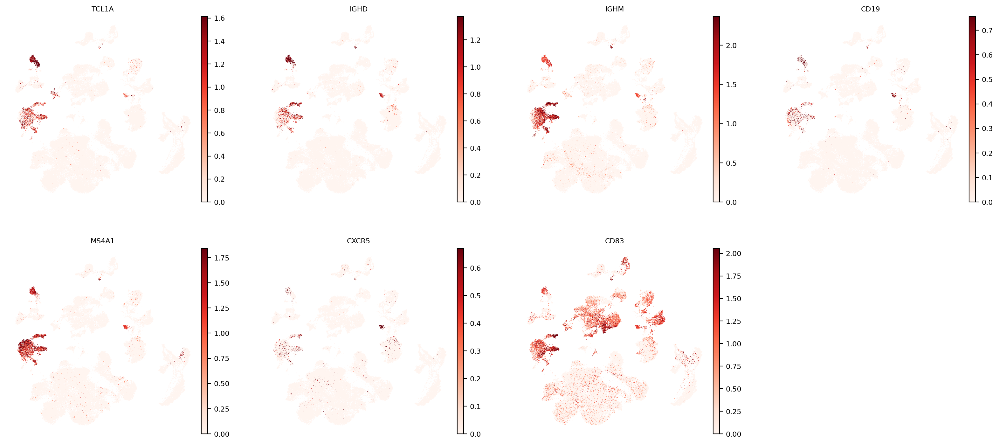

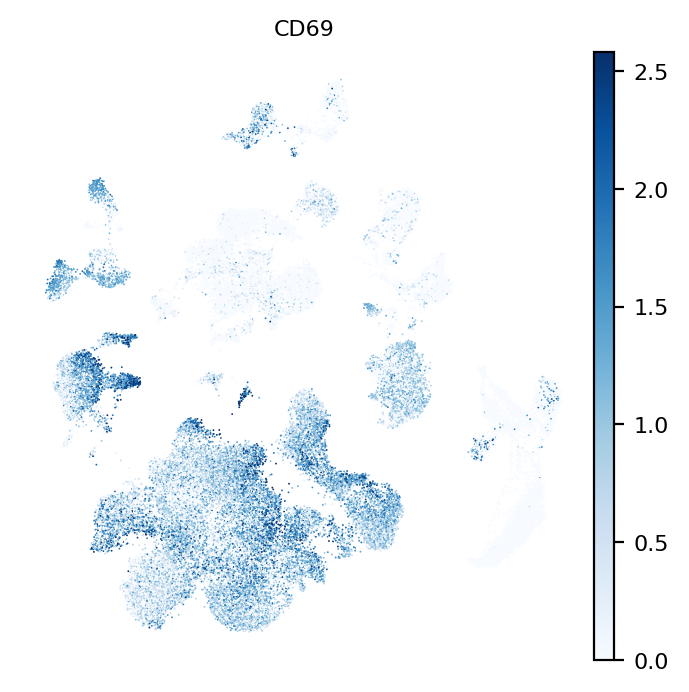

NK cells:


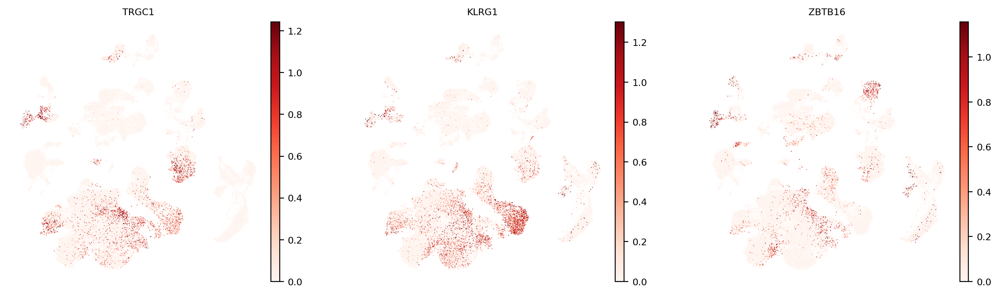

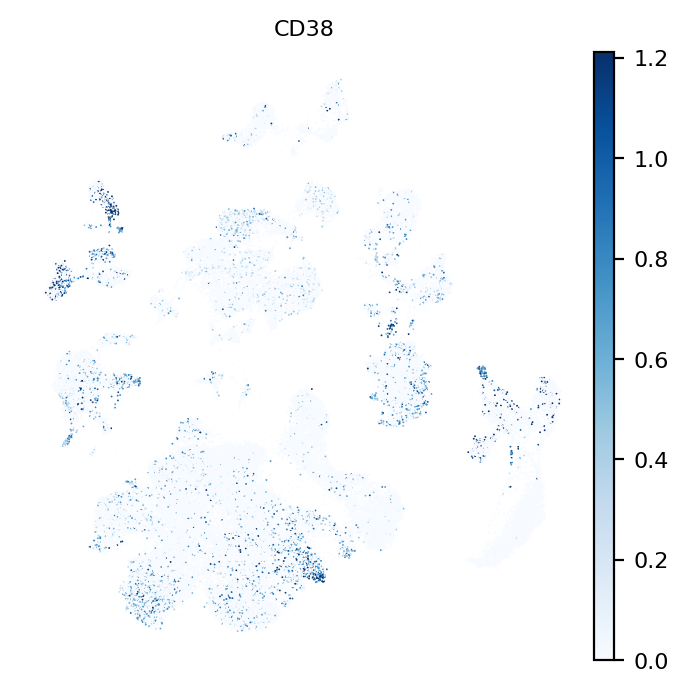

Naïve T cells:


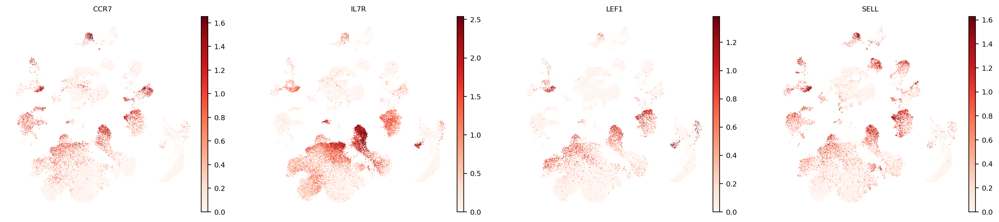

Plasma cells:


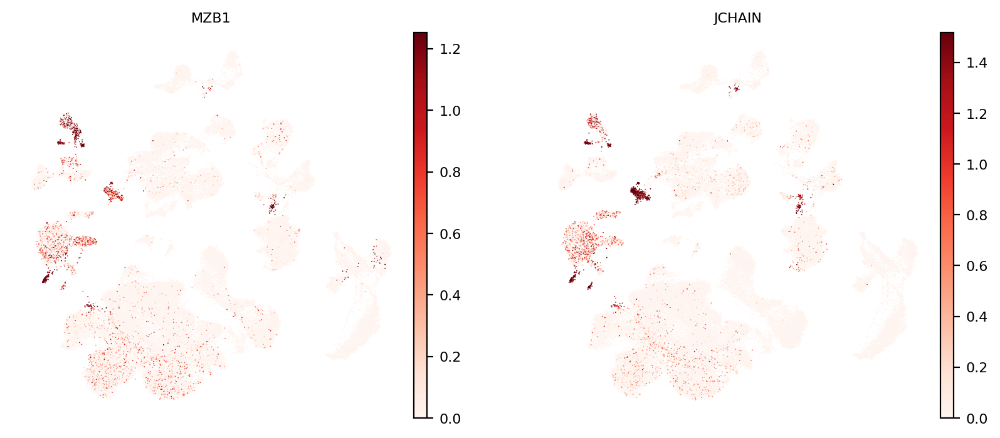

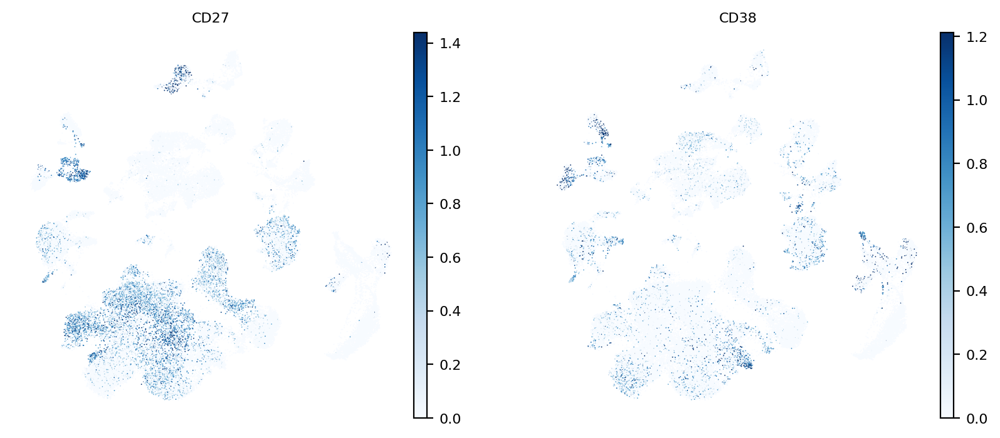

In [178]:
# Plot
for cell, markers in immune_markers_final.items():
    if cell in immune:
        print(f"{cell}:")

        if cell in immune_markers_unique.keys():
            # Plot unique markers in RED
            sc.pl.umap(
                adata,
                color=immune_markers_unique[cell],
                vmin=0,
                vmax="p99", 
                sort_order=False,  
                frameon=False,
                cmap="Reds")

            # If there are non unique markers, plot those in BLUE
            set1 = set(immune_markers_unique[cell])
            set2 = set(immune_markers_final[cell])

            # Get the unique elements between the two lists if they exist
            non_unique_markers = set1.symmetric_difference(set2)

            # If they exist, plot
            if non_unique_markers:
                non_unique_markers = list(non_unique_markers)
                # Plot
                sc.pl.umap(
                    adata,
                    color=non_unique_markers,
                    vmin=0,
                    vmax="p99",  
                    sort_order=False,
                    frameon=False,
                    cmap="Blues")
        else:
            # The cell type has no unique markers, so plot all markers in BLUE
            sc.pl.umap(
                adata,
                color=immune_markers_final[cell],
                vmin=0,
                vmax="p99",  
                sort_order=False,  
                frameon=False,
                cmap="Blues")

Labelling clusters by DEGs

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Li

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


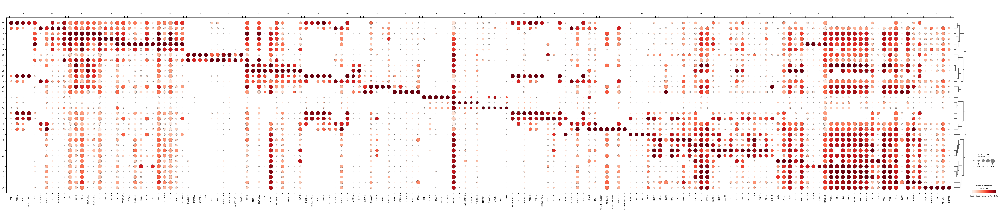

In [162]:
# Supplement annotation by dot plot of cluster DEGS
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/Figures'

# Calculate DEGs
sc.tl.rank_genes_groups(
    adata, groupby="leiden_res_0.7", method="wilcoxon", key_added="dea_leiden_0.7"
)

# Visualize dot plot
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden_res_0.7", standard_scale="var", n_genes=5, key="dea_leiden_0.7",
    save='immune_subset_deg_dotplot.png'
)

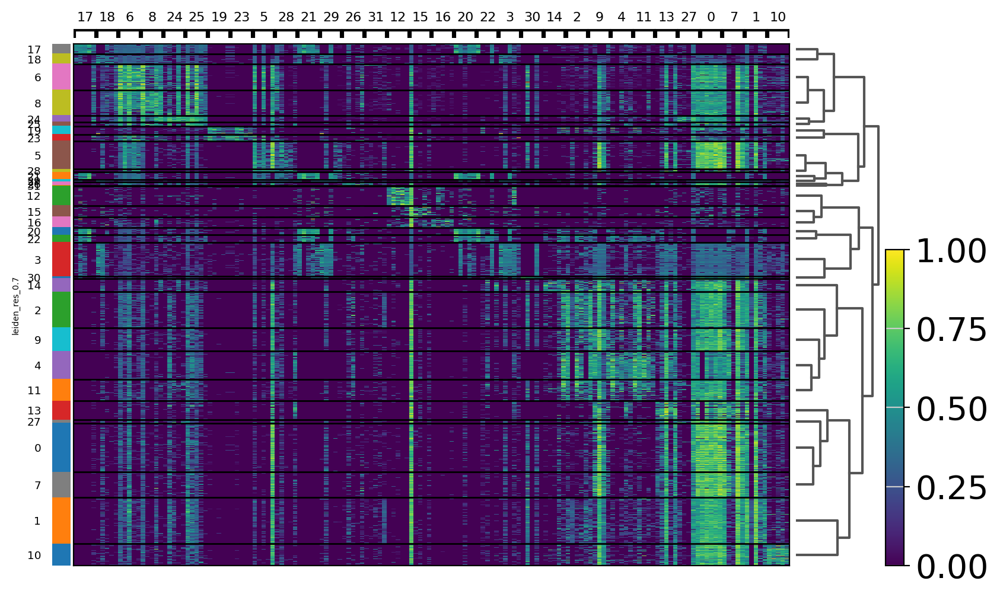

In [174]:
# Visualize DEGs as dot plot
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden_res_0.7", standard_scale="var", n_genes=5, key="dea_leiden_0.7",
    save='immune_subset_deg_dotplot.png'
)

# Visualize DEGs as heat map
sc.pl.rank_genes_groups_heatmap(
    adata, groupby="leiden_res_0.7", standard_scale="var", n_genes=5, key="dea_leiden_0.7",
    save='immune_subset_deg_heatmap.png'
)

In [3]:
# Convert and sort
clusters = list(adata.obs['leiden_res_0.7'].unique())

for index, i in enumerate(clusters):
    clusters[index] = int(i)

clusters.sort()

In [4]:
# Access the results stored in 'uns' attribute
degs_results = adata.uns['dea_leiden_0.7']

for i in clusters:

    # Get the names of the top 5 genes for the specified cluster
    print(f'Cluster {i}:', list(degs_results['names'][f'{i}'][:5]))

Cluster 0: ['RPS6', 'RPL32', 'RPLP2', 'RPL18A', 'RPS27']
Cluster 1: ['TPT1', 'IGKC', 'RPLP1', 'CREM', 'CD52']
Cluster 2: ['CCL5', 'IGKC', 'NKG7', 'CST7', 'SRSF2']
Cluster 3: ['MT-ATP8', 'MT-ND3', 'GNB2L1', 'GNAS', 'MYH9']
Cluster 4: ['NKG7', 'GZMH', 'CCL4', 'JUND', 'IER2']
Cluster 5: ['CD74', 'MS4A1', 'HLA-DRA', 'IGHM', 'RPL18A']
Cluster 6: ['FTL', 'CD74', 'FTH1', 'HLA-DRA', 'HLA-DPB1']
Cluster 7: ['RPL34', 'ZFP36L2', 'IL7R', 'RPL41', 'RPL21']
Cluster 8: ['FTL', 'IER3', 'CXCL8', 'SAT1', 'TYROBP']
Cluster 9: ['CCL5', 'ZFP36L2', 'RPS27', 'RPS29', 'DUSP2']
Cluster 10: ['DNAJB1', 'HSPA1A', 'HSPE1', 'HSP90AA1', 'HSPA1B']
Cluster 11: ['NKG7', 'CCL5', 'GNLY', 'CCL4', 'GZMB']
Cluster 12: ['SPP1', 'AUTS2', 'MEG3', 'RBFOX1', 'CNTNAP2']
Cluster 13: ['IL7R', 'SARAF', 'RPL30', 'JUND', 'RPS21']
Cluster 14: ['CMC1', 'XCL2', 'XCL1', 'CD7', 'NKG7']
Cluster 15: ['MALAT1', 'NPY', 'ARHGAP15', 'SNX29P2', 'ANKRD44']
Cluster 16: ['PLXDC2', 'SLC8A1', 'DOCK4', 'C10orf11', 'DPYD']
Cluster 17: ['GPX1', 'ATP5E', 

In [ ]:
# Remove cells in cluster 12 and recalculate HVGs - relabel as neuronal for large atlas

In [6]:
# Get top 10 DEGs for clusters of interest
i = 10
print(f'Cluster {i}:', list(degs_results['names'][f'{i}'][:10]))

Cluster 10: ['DNAJB1', 'HSPA1A', 'HSPE1', 'HSP90AA1', 'HSPA1B', 'HSPD1', 'HSPB1', 'HSPH1', 'CACYBP', 'HSPA8']


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


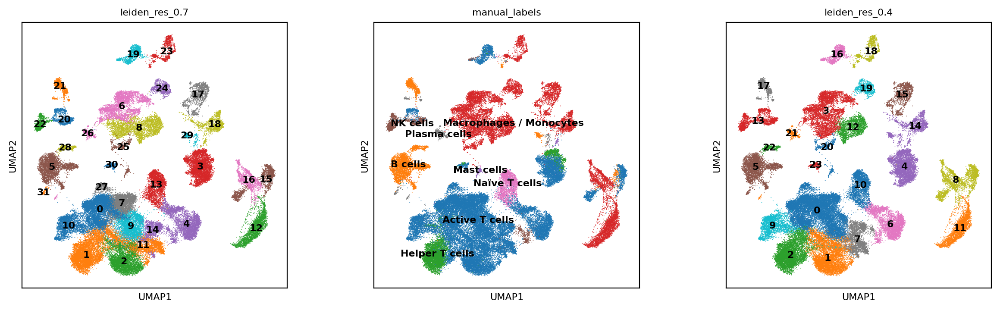

In [49]:
# Plot
# Using 0.4 resolution 
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/Figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

sc.pl.umap(
    adata,
    color=['leiden_res_0.7','manual_labels', 'leiden_res_0.4'],
    palette=colors,
    legend_loc="on data",
    #save='Immune_subset_clusters.png'
)

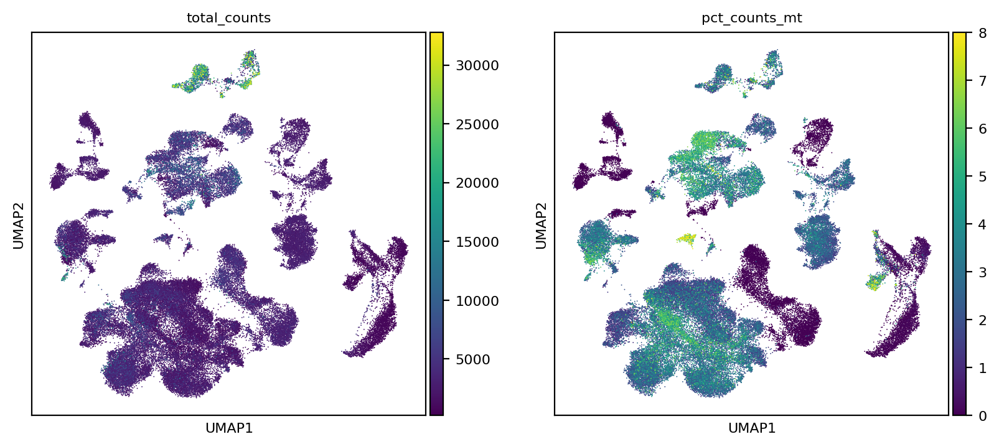

In [10]:
sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)
sc.pl.umap(adata, color=["total_counts", "pct_counts_mt"], save='_immune_cluster_quality_plots.png')

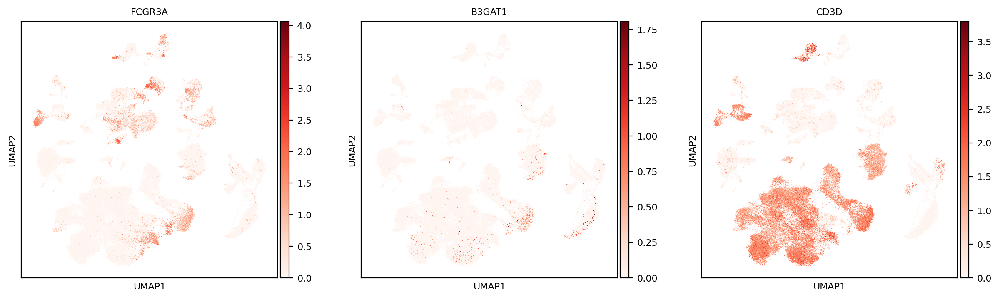

In [48]:
# sc.settings.figdir = '/project/data/gew123/Cell_Annotation/immune_subset_figures'
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

sc.pl.umap(adata, color=['FCGR3A', 'B3GAT1', 'CD3D'], cmap='Reds') #save='_nk_differentiation.png')

NK cell markers:


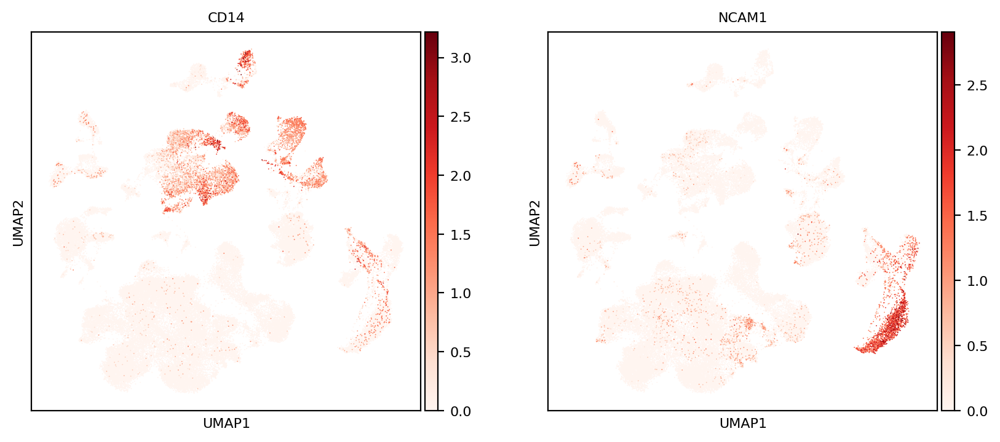

Monocyte (myeloid) markers:


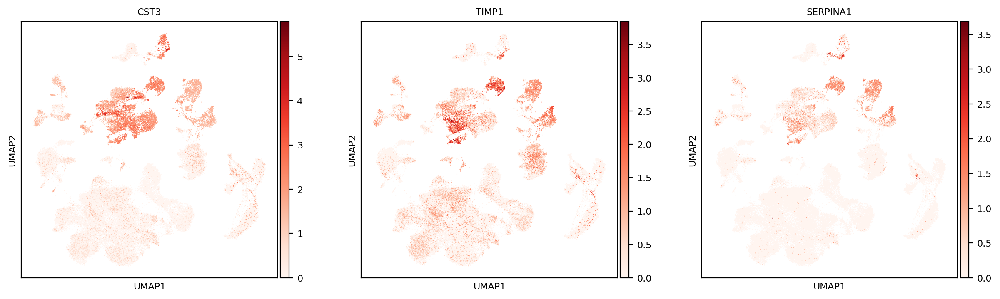

In [30]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=400, fontsize=8)

print('NK cell markers:')
sc.pl.umap(adata, color=['CD14', 'NCAM1'], cmap='Reds')#, save='_nk_differentiation.png')
print('Monocyte (myeloid) markers:')
sc.pl.umap(adata, color=['CST3', 'TIMP1', 'SERPINA1'], cmap='Reds')#, save='_nk_differentiation.png')

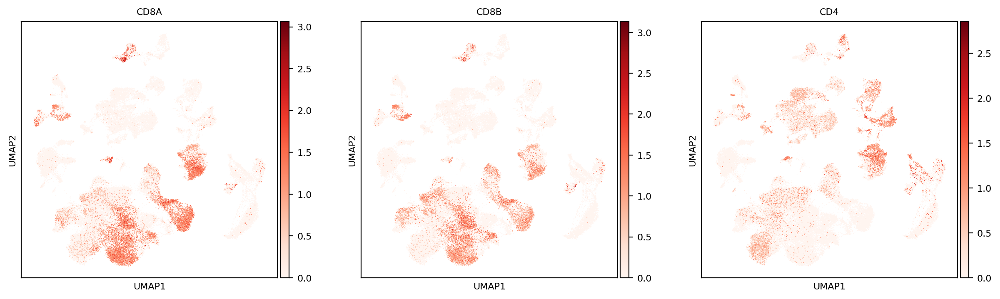

In [17]:
sc.pl.umap(adata, color=['CD8A', 'CD8B', 'CD4'], cmap='Reds')#, save='_nk_differentiation.png')

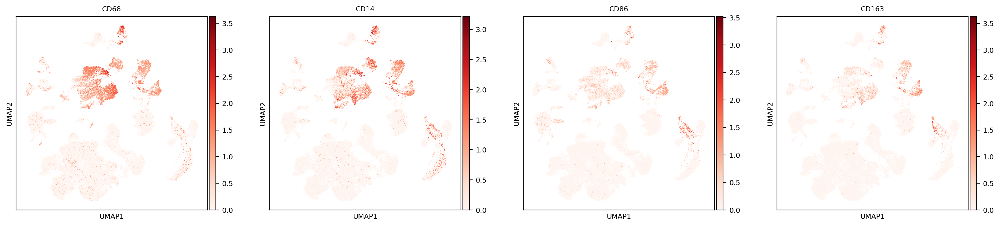

In [39]:
sc.pl.umap(adata, color=['CD68', 'CD14', 'CD163'], cmap='Reds')#, save='_macrophage_differentiation.png')

In [132]:
# Specific cell markers
markers_specific = {
    'Tregs' : ['FOXP3', 'STAT5A', 'CTLA4'],
    'Cytotoxic (CD8+) T cells' : ['CD8A', 'CD8B', 'CD28', 'CD3E'],
    'Helper (CD4+) T cells' : ['CD4', 'CD3E'],
    'Macrophages' : ['CD68', 'CD163', 'CD14'],
    'B cells' : ['CD19', 'IGHD', 'IGHM', 'TCL1A', 'MS4A1', 'CD79A']
    'Plasma cells' : ['PRDM1', 'SDC1', 'CD38'],
    'NK cells' : ['NCAM1'] # NCAM1 = CD56 # Check if CD16 and CD57 are in data

}

# General cell markers
markers_general = {'Myeloid cells' : ['CST3']
           'T cells' : ['CD3E', 'CD3D', 'CD3G', 'CD28', 'CD69', 'CX3CR1']
          }

# Turn into a single list
markers_list = []
for key, val in markers_specific.items():
    for i in val:
        markers_list.append(i)
markers_list

['FOXP3',
 'STAT5A',
 'CTLA4',
 'CD8A',
 'CD8B',
 'CD28',
 'CD3E',
 'CD4',
 'CD3E',
 'CD68',
 'CD163',
 'CD14',
 'CD19',
 'IGHD',
 'IGHM',
 'TCL1A',
 'MS4A1',
 'PRDM1',
 'SDC1',
 'CD38',
 'CD3E',
 'CD3D',
 'CD3G',
 'CD28',
 'CD69',
 'CX3CR1']

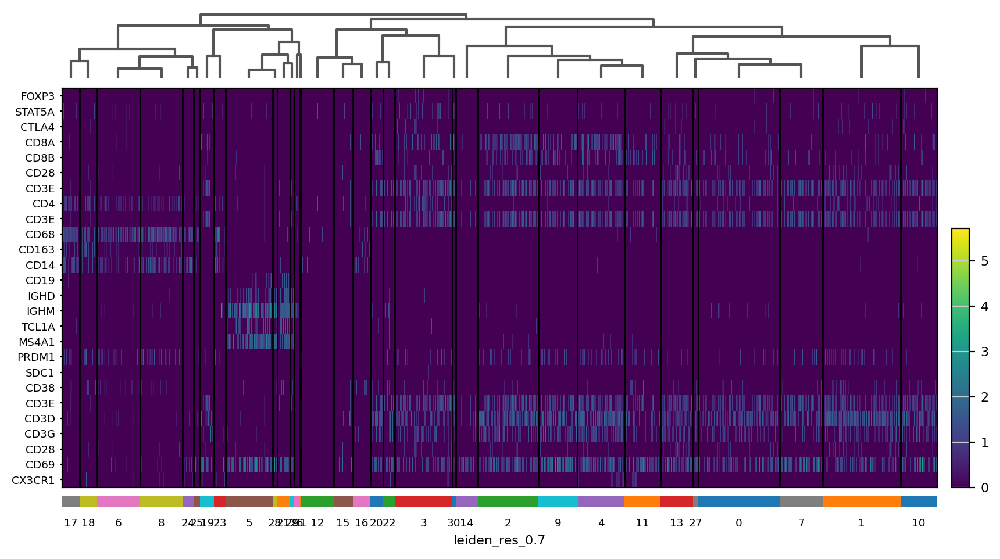

In [133]:
sc.pl.heatmap(adata, markers_list, groupby='leiden_res_0.7', swap_axes=True, dendrogram=True)

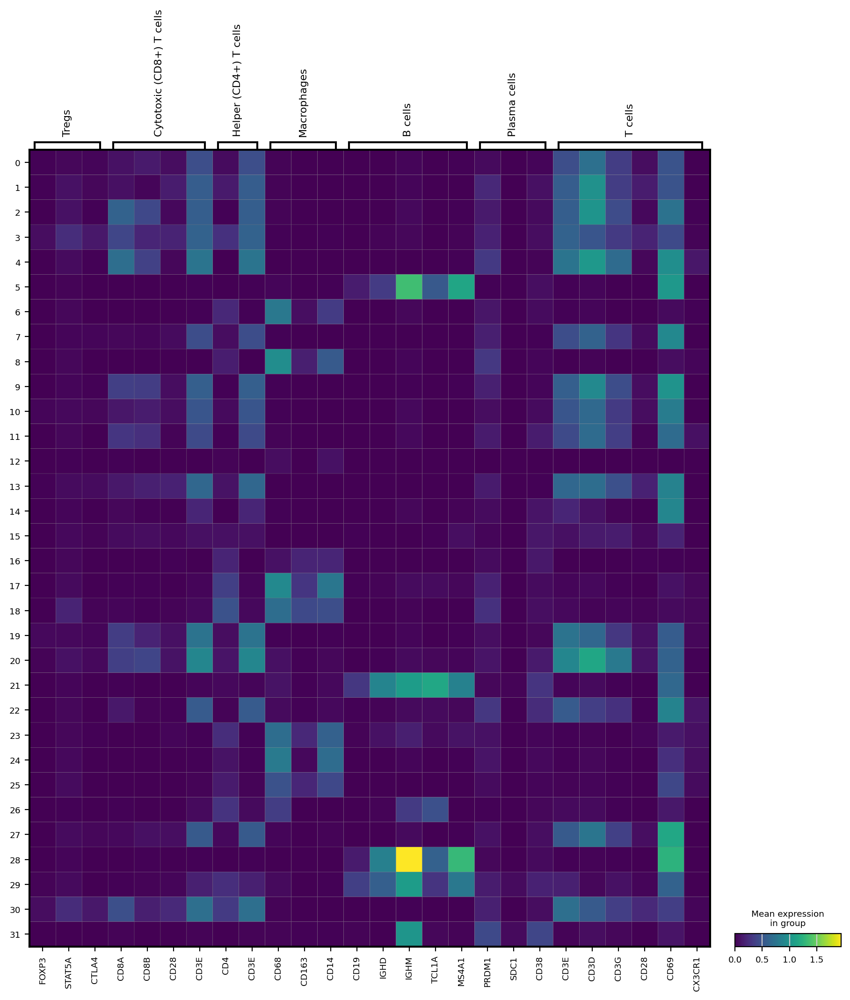

In [155]:
sc.pl.matrixplot(adata, markers, groupby='leiden_res_0.7', cmap='viridis')

# Use this for the final matrix plot

mp = sc.pl.matrixplot(adata, markers, groupby='leiden_res_0.6', cmap='viridis', return_fig=True)
mp.add_totals().style(edge_color='black').show()